In [ ]:
 import numpy as np


In [ ]:
import pandas as pd

In [ ]:
dict ={"name":['arjun','kabir','rahu'],"marks":['34','34','67']}

In [ ]:
df=pd.DataFrame(dict)

In [ ]:
df

,name,marks
0,arjun,34
1,kabir,34
2,rahu,67


In [ ]:
df.to_csv("admit.csv")

In [ ]:
df.describe()

,name,marks
count,3,3
unique,3,2
top,arjun,34
freq,1,2


In [ ]:
admit=pd.read_csv("admit.csv")

In [ ]:
from google.colab import files
uploaded = files.upload()


Saving R.jpg to R.jpg


In [ ]:
from PIL import Image
import io

# Load the image
image = Image.open(io.BytesIO(uploaded['R.jpg']))


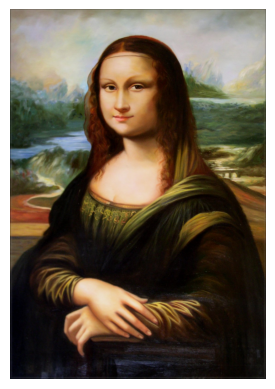

In [ ]:
import matplotlib.pyplot as plt

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()


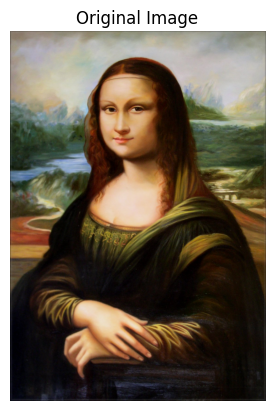

In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import io

# Load the image
image = cv2.imdecode(np.frombuffer(uploaded['R.jpg'], np.uint8), cv2.IMREAD_COLOR)

# Display the original image
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Original Image')
plt.show()


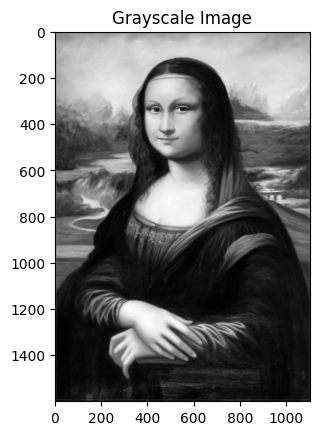

In [ ]:
# Convert the image to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Display the grayscale image
plt.imshow(gray_image, cmap='gray')
plt.axis('on')
plt.title('Grayscale Image')
plt.show()


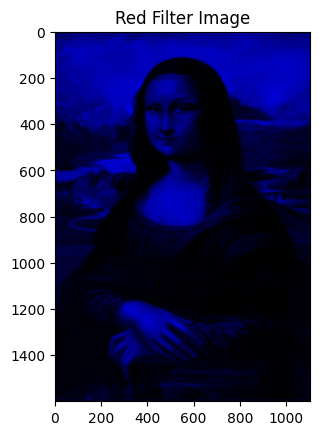

In [ ]:
# Apply a red filter to the image
red_filter = image.copy()
red_filter[:, :, 1] = 0  # Set the green channel to 0
red_filter[:, :, 2] = 0  # Set the blue channel to 0

# Display the red-filtered image
plt.imshow(cv2.cvtColor(red_filter, cv2.COLOR_BGR2RGB))
plt.axis('on')
plt.title('Red Filter Image')
plt.show()


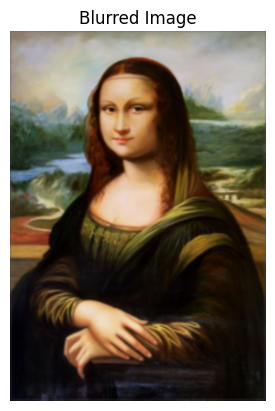

In [ ]:
# Apply Gaussian Blur
blurred_image = cv2.GaussianBlur(image, (15, 15), 0)

# Display the blurred image
plt.imshow(cv2.cvtColor(blurred_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Blurred Image')
plt.show()


In [ ]:
# Load the image
image = cv2.imdecode(np.frombuffer(uploaded['R.jpg'], np.uint8), cv2.IMREAD_COLOR)

# Convert the image to a matrix
image_matrix = np.array(image)


In [ ]:
print(image_matrix)


[[[ 86  95 105]
  [ 91 100 110]
  [ 94 103 113]
  ...
  [ 86  98 102]
  [ 85  96 100]
  [ 83  94  98]]

 [[ 86  95 105]
  [ 93 102 112]
  [100 109 119]
  ...
  [ 95 107 111]
  [ 92 103 107]
  [ 88  99 103]]

 [[ 83  92 102]
  [ 93 102 112]
  [102 112 122]
  ...
  [104 116 120]
  [ 97 109 113]
  [ 89 101 105]]

 ...

 [[ 18   9   6]
  [ 24  15  12]
  [ 30  21  17]
  ...
  [ 34  32  32]
  [ 31  29  29]
  [ 28  26  26]]

 [[ 20  11   7]
  [ 26  17  13]
  [ 30  21  17]
  ...
  [ 29  27  27]
  [ 26  24  24]
  [ 24  22  22]]

 [[ 18   9   5]
  [ 23  14  10]
  [ 25  16  12]
  ...
  [ 23  21  21]
  [ 21  19  19]
  [ 19  17  17]]]


In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Load the image
image = cv2.imdecode(np.frombuffer(uploaded['R.jpg'], np.uint8), cv2.IMREAD_COLOR)

# Convert the image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply thresholding to create a binary image
_, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)


In [ ]:
# Define a kernel for morphological operations
kernel = np.ones((3, 9), np.uint8)

# Remove noise
opening = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)

# Find sure background area
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Find sure foreground area
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
_, sure_fg = cv2.threshold(dist_transform, 0.7*dist_transform.max(), 255, 0)

# Find unknown region
sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(sure_bg, sure_fg)


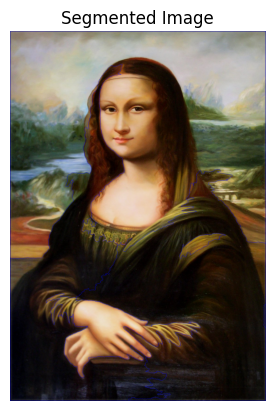

In [ ]:
# Marker labelling
_, markers = cv2.connectedComponents(sure_fg)

# Add one to all labels to make sure background is not 0, but 1
markers = markers + 1

# Mark the region of unknown with zero
markers[unknown == 255] = 0

# Apply watershed
markers = cv2.watershed(image, markers)
image[markers == -1] = [255, 1, 0]

# Display the segmented image
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Segmented Image')
plt.show()


In [ ]:
from google.colab import files
uploaded = files.upload()

# Print the keys of the uploaded dictionary
print(uploaded.keys())


Saving R.jpg to R (1).jpg
dict_keys(['R (1).jpg'])


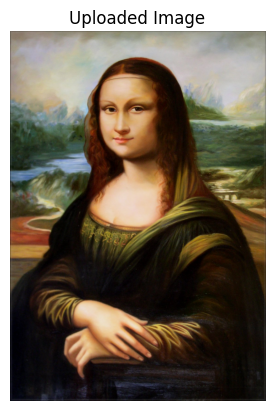

In [ ]:
from PIL import Image
import io

# Use the actual file name from the uploaded dictionary
file_name = list(uploaded.keys())[0]
image = Image.open(io.BytesIO(uploaded[file_name]))

# Display the image
import matplotlib.pyplot as plt
plt.imshow(image)
plt.axis('off')
plt.title('Uploaded Image')
plt.show()


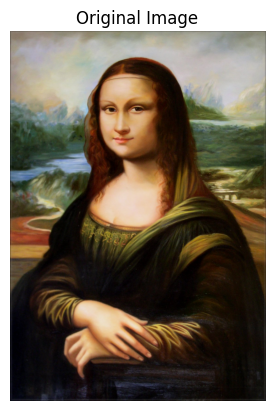

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Load the uploaded image
image_path = list(uploaded.keys())[0]
image = cv2.imdecode(np.frombuffer(uploaded[image_path], np.uint8), cv2.IMREAD_COLOR)

# Display the original image
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Original Image')
plt.show()


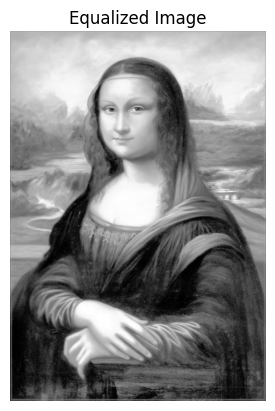

In [ ]:
# Convert to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply histogram equalization
equalized_image = cv2.equalizeHist(gray)

# Display the equalized image
plt.imshow(equalized_image, cmap='gray')
plt.axis('off')
plt.title('Equalized Image')
plt.show()


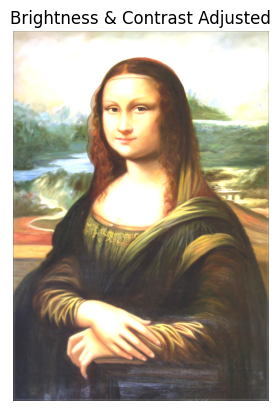

In [ ]:
# Function to adjust brightness and contrast
def adjust_brightness_contrast(image, brightness=0, contrast=0):
    beta = brightness
    alpha = contrast / 127 + 1
    adjusted_image = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)
    return adjusted_image

# Adjust brightness and contrast
brightness = 50
contrast = 30
adjusted_image = adjust_brightness_contrast(image, brightness, contrast)

# Display the brightness and contrast adjusted image
plt.imshow(cv2.cvtColor(adjusted_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Brightness & Contrast Adjusted')
plt.show()


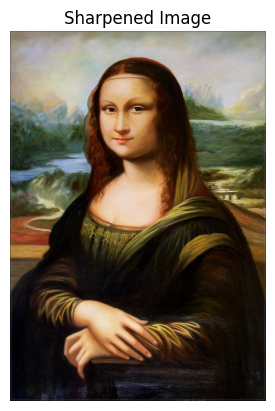

In [ ]:
# Sharpening kernel
kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])

# Apply sharpening kernel
sharpened_image = cv2.filter2D(image, -1, kernel)

# Display the sharpened image
plt.imshow(cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Sharpened Image')
plt.show()


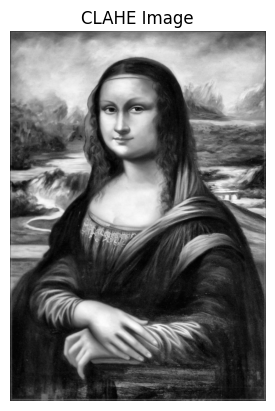

In [ ]:
# Convert to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply CLAHE
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_image = clahe.apply(gray)

# Display the CLAHE image
plt.imshow(clahe_image, cmap='gray')
plt.axis('off')
plt.title('CLAHE Image')
plt.show()


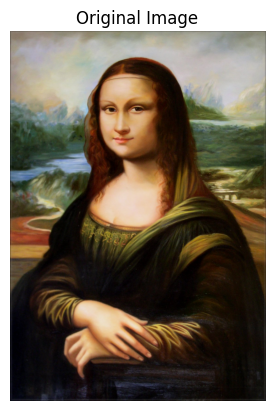

In [ ]:
import cv2
import numpy as np

# Load the uploaded image
image_path = list(uploaded.keys())[0]
image = cv2.imdecode(np.frombuffer(uploaded[image_path], np.uint8), cv2.IMREAD_COLOR)

# Display the original image
from matplotlib import pyplot as plt
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Original Image')
plt.show()


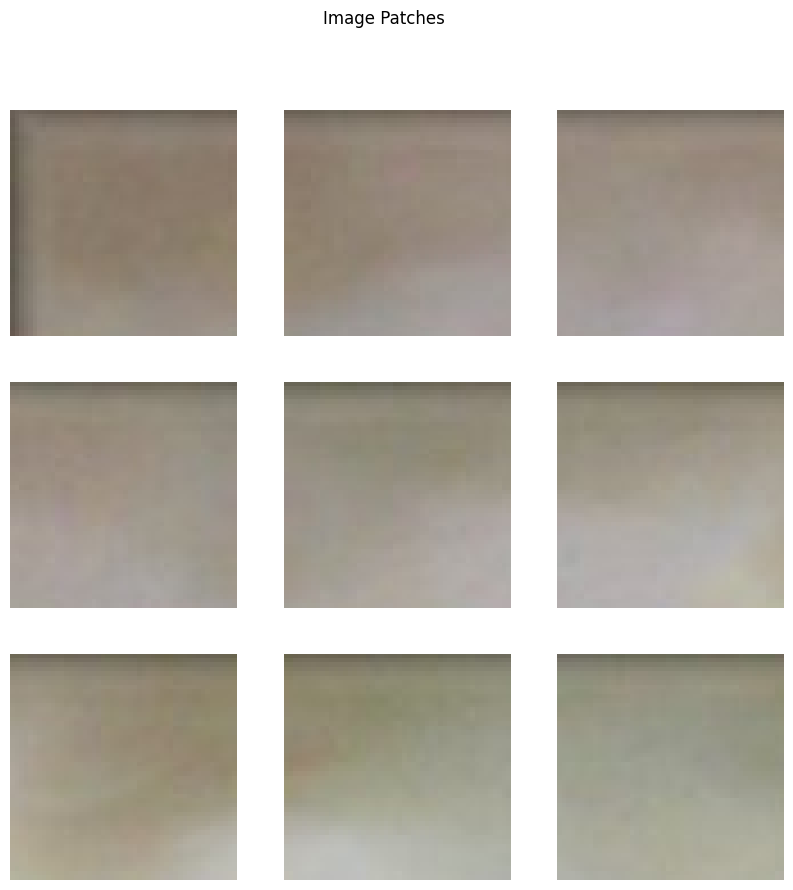

In [ ]:
def segment_image(image, patch_size):
    height, width, _ = image.shape
    patches = []

    # Iterate over the image with a sliding window
    for y in range(0, height, patch_size):
        for x in range(0, width, patch_size):
            # Extract the patch
            patch = image[y:y+patch_size, x:x+patch_size]
            patches.append(patch)

    return patches

# Define patch size (e.g., 50x50 pixels)
patch_size = 50

# Segment the image into patches
patches = segment_image(image, patch_size)

# Display a few patches
num_patches = min(9, len(patches))
plt.figure(figsize=(10, 10))
for i in range(num_patches):
    plt.subplot(3, 3, i+1)
    plt.imshow(cv2.cvtColor(patches[i], cv2.COLOR_BGR2RGB))
    plt.axis('off')
plt.suptitle('Image Patches')
plt.show()


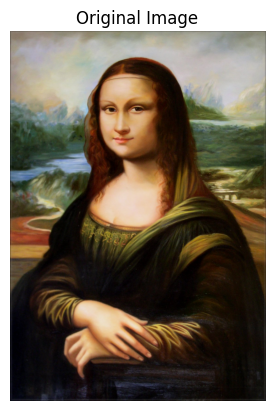

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Load the uploaded image
image_path = list(uploaded.keys())[0]
image = cv2.imdecode(np.frombuffer(uploaded[image_path], np.uint8), cv2.IMREAD_COLOR)

# Display the original image
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Original Image')
plt.show()


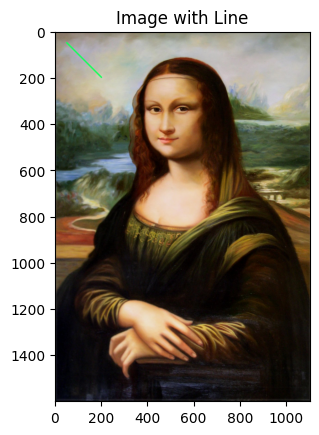

In [ ]:
# Define the starting and ending points of the line
start_point = (50, 50)
end_point = (200, 200)

# Define the color (BGR format) and thickness of the line
color = (90, 340, 20)  # Green color
thickness = 5

# Draw the line on the image
cv2.line(image, start_point, end_point, color, thickness)

# Display the image with the line
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('on')
plt.title('Image with Line')
plt.show()


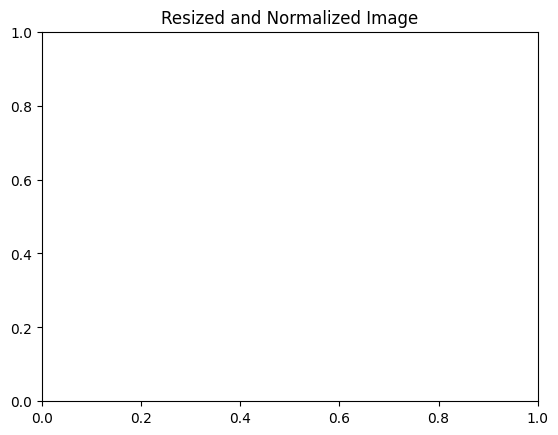

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Load the uploaded image
image_path = list(uploaded.keys())[0]
image = cv2.imdecode(np.frombuffer(uploaded[image_path], np.uint8), cv2.IMREAD_COLOR)

# Resize the image to the desired input size for the model (e.g., 256x256)
resized_image = cv2.resize(image, (256, 256))

# Normalize the image
normalized_image = resized_image / 255.0

# Expand dimensions to fit model input shape
input_image = np.expand_dims(normalized_image, axis=0)
plt.axis('on')
plt.title('Resized and Normalized Image')
plt.show()

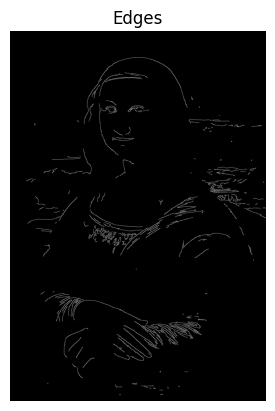

In [ ]:
# Apply Canny edge detector
edges = cv2.Canny(image, 100, 200)

# Display the edges
plt.imshow(edges, cmap='gray')
plt.axis('off')
plt.title('Edges')
plt.show()


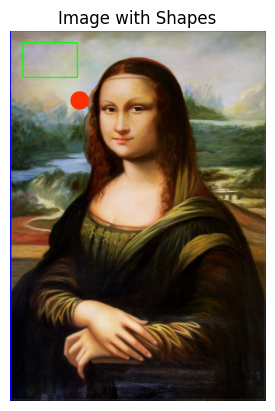

In [ ]:
# Draw a line
cv2.line(image, (0, 0), (image.shape[2], image.shape[0]), (255, 0, 0), 5)

# Draw a rectangle
cv2.rectangle(image, (55, 50), (290, 200), (0, 255, 0), 3)

# Draw a circle
cv2.circle(image, (300, 300), 40, (0, 45, 355), -1)

# Display the image with shapes
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Image with Shapes')
plt.show()


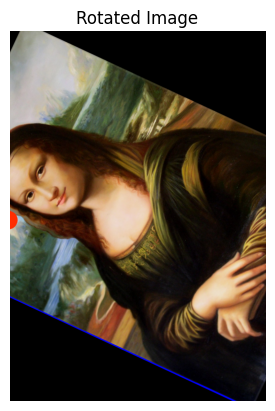

In [ ]:
# Get the rotation matrix
center = (image.shape[1] // 2, image.shape[0] // 2)
matrix = cv2.getRotationMatrix2D(center, 65, 1.0)

# Perform the rotation
rotated_image = cv2.warpAffine(image, matrix, (image.shape[1], image.shape[0]))

# Display the rotated image
plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Rotated Image')
plt.show()


In [ ]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
import numpy as np

# Load the pre-trained ResNet50 model
model = ResNet50(weights='imagenet')

# Load and preprocess the image
img_path = list(uploaded.keys())[0]
img = image.load_img(img_path, target_size=(224, 224))
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# Perform classification
preds = model.predict(img_array)
print('Predicted:', decode_predictions(preds, top=3)[0])
plt.show()


102967424/102967424 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
35363/35363 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Predicted: [('n03770439', 'miniskirt', 0.34884074), ('n03404251', 'fur_coat', 0.123324916), ('n07248320', 'book_jacket', 0.06767367)]


In [ ]:
pip install scikit-learn numpy pandas matplotlib


In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Load the Iris dataset
iris = datasets.load_iris()
X = iris.data
y = iris.target

# Convert to DataFrame for easier analysis
df = pd.DataFrame(data=np.c_[iris['data'], iris['target']],
                  columns=iris['feature_names'] + ['target'])

# Display the first few rows of the DataFrame
print(df.head())


   sepal length (cm)  sepal width (cm)  petal length (cm)  petal width (cm)  \
0                5.1               3.5                1.4               0.2   
1                4.9               3.0                1.4               0.2   
2                4.7               3.2                1.3               0.2   
3                4.6               3.1                1.5               0.2   
4                5.0               3.6                1.4               0.2   

   target  
0     0.0  
1     0.0  
2     0.0  
3     0.0  
4     0.0  


In [ ]:
import numpy as np
import pandas as pd
import cv2
from skimage import io
import matplotlib.pyplot as plt
from PIL import Image

(1600, 1104, 3)
int64


Text(0.5, 1.0, 'Nature Image')

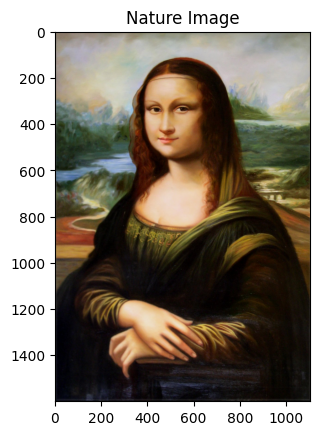

In [ ]:
img=io.imread('R.jpg')
img=np.array(img)
img=img.astype('int')
print(img.shape)
print(img.dtype)

plt.imshow(img)
plt.title("Nature Image")

Text(0.5, 1.0, 'Nature Image')

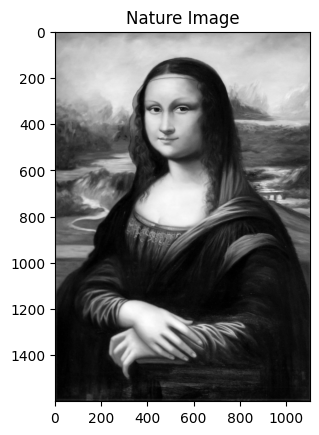

In [ ]:
img_grey=cv2.imread('R.jpg',0)
plt.imshow(img_grey,cmap='gray' )
plt.title("Nature Image")


Text(0.5, 1.0, 'Red band')

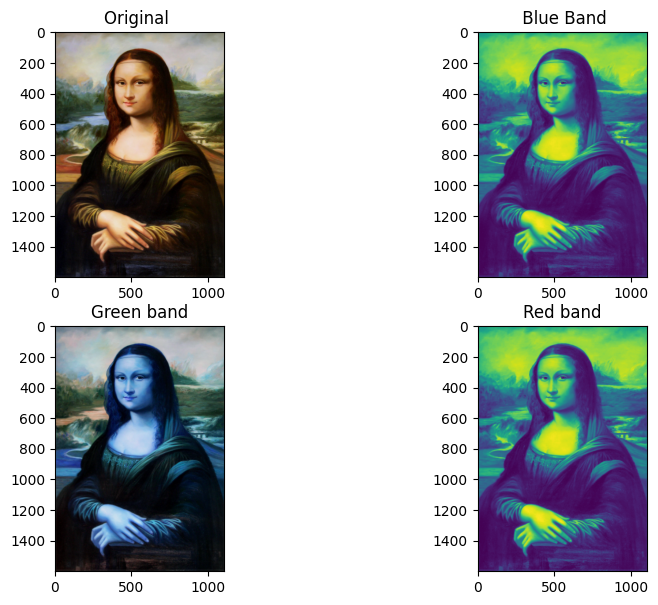

In [ ]:
blue = cv2.imread('R.jpg',0)
red = cv2.imread('R.jpg',2)
green = cv2.imread('R.jpg',1)

fig=plt.figure(figsize=(10,7))
fig.add_subplot(2,2,1)
plt.imshow( img)
plt.title( "Original " )

fig.add_subplot (2, 2, 2)
plt . imshow(blue)
plt.title( " Blue Band")

fig.add_subplot (2, 2, 3)
plt.imshow(green)
plt.title("Green band")

fig.add_subplot(2,2,4)
plt.imshow(red)
plt.title("Red band")

Text(0.5, 1.0, 'Red band')

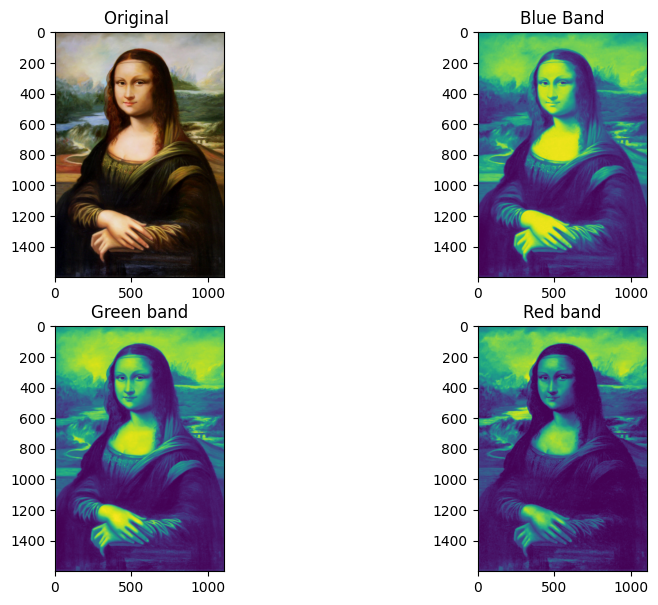

In [ ]:
(b_channel, g_channel, r_channel) = cv2.split(img)
fig=plt.figure(figsize=(10,7))
fig.add_subplot (2, 2, 1)
plt .imshow( img)
plt . title ( "Original " )

fig.add_subplot (2, 2, 2)
plt . imshow( b_channel)
plt.title ("Blue Band")

fig.add_subplot(2,2,3)
plt . imshow(g_channel)
plt.title("Green band")

fig. add_subplot (2, 2, 4)
plt. imshow( r_channel)
plt.title("Red band")


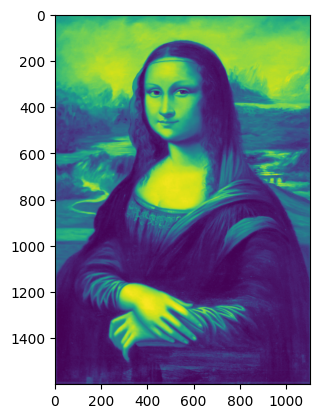

In [ ]:
neg_img=np.abs (img_grey - 255)
plt.imshow(neg_img)

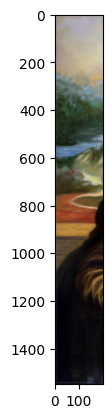

In [ ]:
plt.imshow(img[50:,0:200,:])

In [ ]:
hist=np.histogram(img_grey,bins=256)
print(hist)

(array([ 2222,  7035,  9759, 11948, 14440, 18275, 22768, 28262,     0,
       32604, 35886, 38225, 39805, 40243, 39230, 37668, 34765,     0,
       32187, 28522, 25381, 22341, 20006, 18079, 16630,     0, 15703,
       14606, 13710, 12774, 12230, 11638, 10878, 10458,     0,  9915,
        9643,  9213,  9217,  8893,  8662,  8398,     0,  8036,  7836,
        7662,  7447,  7180,  7254,  7214,  6999,     0,  6873,  6803,
        6768,  6588,  6461,  6543,  6408,     0,  6565,  6604,  6770,
        6383,  6251,  6108,  5914,  5772,     0,  5389,  5420,  5445,
        5440,  5483,  5528,  5680,     0,  5849,  6052,  5987,  6198,
        6374,  6341,  6576,  6706,     0,  6667,  6762,  6731,  6830,
        6747,  6546,  6582,     0,  6297,  6238,  6072,  5870,  5784,
        5733,  5699,  5660,     0,  5699,  5470,  5532,  5355,  5235,
        5016,  4878,     0,  4740,  4599,  4576,  4303,  4237,  4119,
        3985,  3908,     0,  3803,  3797,  3623,  3610,  3646,  3463,
        3558,     0

In [ ]:
chans = cv2.split(img)
colors = ("b", "g", "r")


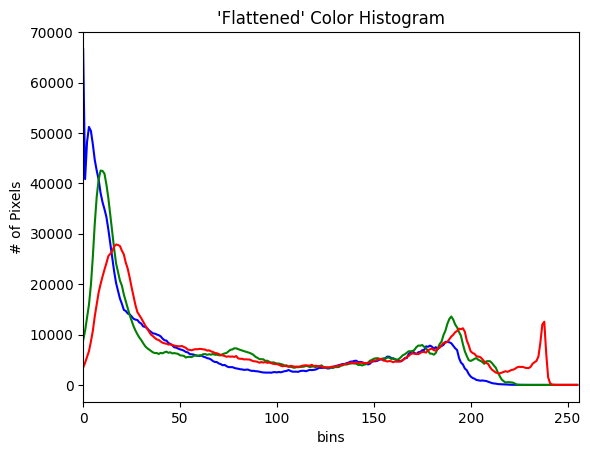

In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

# Load the uploaded image
image_path = list(uploaded.keys())[0]
img = cv.imdecode(np.frombuffer(uploaded[image_path], np.uint8), cv.IMREAD_COLOR)

# Split the image into its channels
chans = cv.split(img)
colors = ("b", "g", "r")

plt.figure()
plt.title("'Flattened' Color Histogram")
plt.xlabel("bins")
plt.ylabel("# of Pixels")

# Loop over the image channels
for (chan, color) in zip(chans, colors):
    # Ensure the channel is in the correct format
    chan = chan.astype('float32')
    # Calculate the histogram for the current channel
    hist = cv.calcHist([chan], [0], None, [256], [0, 256])
    # Plot the histogram
    plt.plot(hist, color=color)
    plt.xlim([0, 256])

plt.show()


(1600, 1104, 3)
uint8


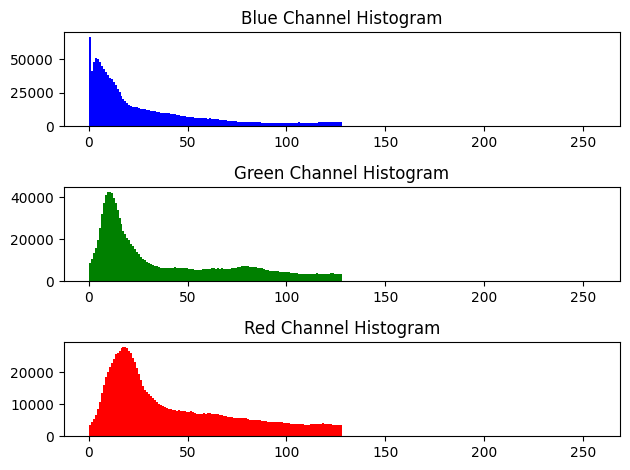

In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

# Load the uploaded image
image_path = list(uploaded.keys())[0]
img = cv.imdecode(np.frombuffer(uploaded[image_path], np.uint8), cv.IMREAD_COLOR)

# Print the shape and type of the image
print(img.shape)
print(img.dtype)

# Ensure the dtype is correctly converted without extra spaces
img = img.astype('int8')

# Plot the histogram for each color channel
plt.subplot(3, 1, 1)
plt.hist(img[:, :, 0].ravel(), bins=256, range=[0, 256], color='b')
plt.title('Blue Channel Histogram')

plt.subplot(3, 1, 2)
plt.hist(img[:, :, 1].ravel(), bins=256, range=[0, 256], color='g')
plt.title('Green Channel Histogram')

plt.subplot(3, 1, 3)
plt.hist(img[:, :, 2].ravel(), bins=256, range=[0, 256], color='r')
plt.title('Red Channel Histogram')

plt.tight_layout()
plt.show()


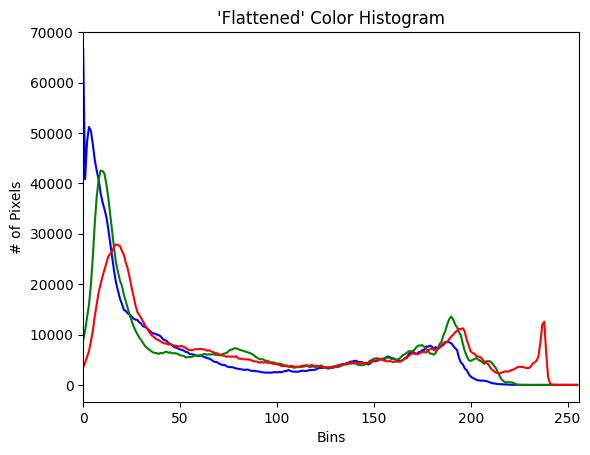

In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

# Load the uploaded image
image_path = list(uploaded.keys())[0]
img = cv.imdecode(np.frombuffer(uploaded[image_path], np.uint8), cv.IMREAD_COLOR)

# Split the image into its channels
chans = cv.split(img)
colors = ("b", "g", "r")

plt.figure()
plt.title("'Flattened' Color Histogram")
plt.xlabel("Bins")
plt.ylabel("# of Pixels")

# Loop over the image channels
for (chan, color) in zip(chans, colors):
    # Calculate the histogram for the current channel
    hist = cv.calcHist([chan], [0], None, [256], [0, 256])
    # Plot the histogram
    plt.plot(hist, color=color)
    plt.xlim([0, 256])

plt.show()


(1600, 1104)
uint8


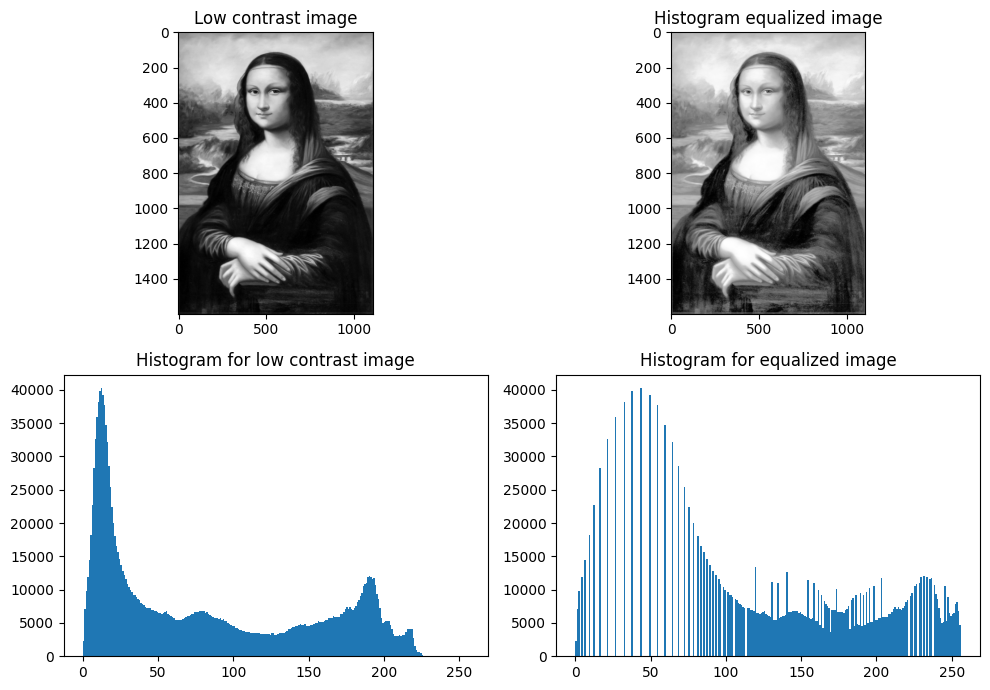

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Load the low contrast image in grayscale
lena_low = cv2.imread('R.jpg', 0)
print(lena_low.shape)
print(lena_low.dtype)

# Apply histogram equalization
lena_hist_eq = cv2.equalizeHist(lena_low)

# Create a figure to display the images and histograms
fig = plt.figure(figsize=(10, 7))

# Display the low contrast image
fig.add_subplot(2, 2, 1)
plt.imshow(lena_low, cmap='gray')
plt.title("Low contrast image")

# Display the histogram equalized image
fig.add_subplot(2, 2, 2)
plt.imshow(lena_hist_eq, cmap='gray')
plt.title("Histogram equalized image")

# Display the histogram for the low contrast image
fig.add_subplot(2, 2, 3)
plt.hist(lena_low.ravel(), bins=256, range=[0, 256])
plt.title("Histogram for low contrast image")

# Display the histogram for the equalized image
fig.add_subplot(2, 2, 4)
plt.hist(lena_hist_eq.ravel(), bins=256, range=[0, 256])
plt.title("Histogram for equalized image")

plt.tight_layout()
plt.show()


In [ ]:
from sklearn.datasets import load_iris
iris_dataset = load_iris()

In [ ]:
print("Keys of iris_dataset: \n{}".format(iris_dataset.keys()))

Keys of iris_dataset: 
dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
 iris_dataset['data'], iris_dataset['target'], random_state=0)

In [ ]:
!pip install mglearn


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 581.4/581.4 kB 27.2 MB/s eta 0:00:00


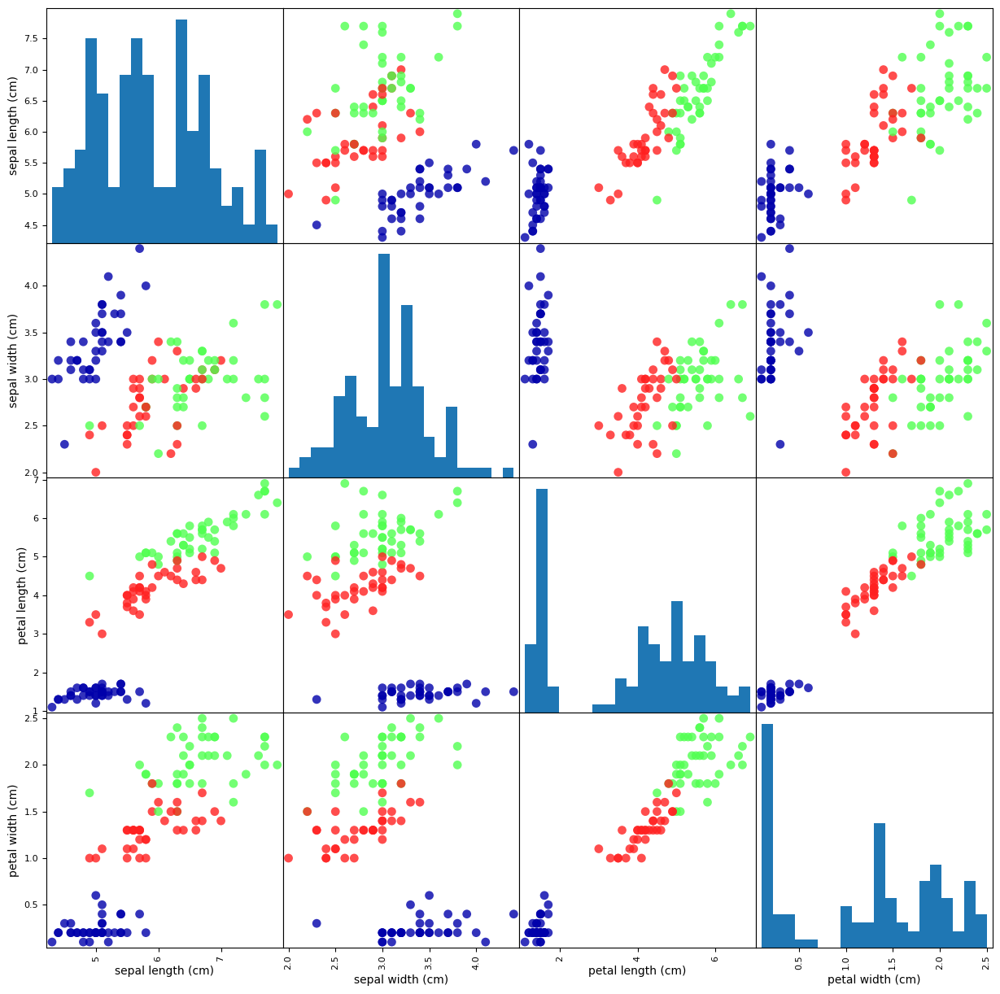

In [ ]:
import pandas as pd
import mglearn as mglearn
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from pandas.plotting import scatter_matrix

# mglearn ko install karo
!pip install mglearn

# Iris dataset ko load karo
iris_dataset = load_iris()
X_train, X_test, y_train, y_test = train_test_split(iris_dataset['data'], iris_dataset['target'], random_state=0)

# DataFrame create karo aur columns ko label karo
iris_dataframe = pd.DataFrame(X_train, columns=iris_dataset.feature_names)

# Scatter matrix create karo aur usse plot karo
grr = scatter_matrix(iris_dataframe, c=y_train, figsize=(15, 15), marker='o', hist_kwds={'bins': 20}, s=60, alpha=.8, cmap=mglearn.cm3)

# Plot ko display karo
plt.show()


In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=1)

In [ ]:
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=1)

X.shape: (26, 2)


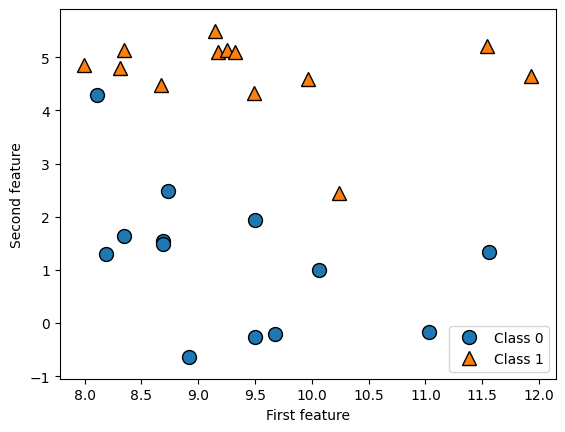

In [ ]:
# generate dataset
X, y = mglearn.datasets.make_forge()
# plot dataset
mglearn.discrete_scatter(X[:, 0], X[:, 1], y)
plt.legend(["Class 0", "Class 1"], loc=4)
plt.xlabel("First feature")
plt.ylabel("Second feature")
print("X.shape: {}".format(X.shape))


In [ ]:
import pandas as pd

# Create a dataset of 30 people
data = {
    'Name': ["John", "Anna", "Peter", "Linda", "Michael", "Sara", "David", "Emily", "Robert", "Jessica",
             "Daniel", "Karen", "Matthew", "Alice", "James", "Rebecca", "Charles", "Sophia", "Paul", "Lisa",
             "George", "Megan", "Andrew", "Olivia", "Edward", "Isabella", "Thomas", "Emma", "Henry", "Grace"],
    'Location': ["New York", "Paris", "Berlin", "London", "Tokyo", "Mumbai", "Sydney", "Toronto", "Dubai", "Rome",
                 "Moscow", "Bangkok", "Shanghai", "Seoul", "Singapore", "Istanbul", "Mexico City", "Cairo",
                 "Buenos Aires", "Lagos", "Kinshasa", "Jakarta", "Karachi", "Dhaka", "Lima", "Beijing", "Kolkata",
                 "Madrid", "Los Angeles", "Chicago"],
    'Age': [24, 13, 53, 33, 45, 29, 41, 27, 37, 31, 25, 47, 39, 26, 34, 32, 50, 28, 48, 21, 35, 30, 22, 49, 42, 38, 36, 40, 23, 46],
    'Gender': ["Male", "Female", "Male", "Female", "Male", "Female", "Male", "Female", "Male", "Female",
               "Male", "Female", "Male", "Female", "Male", "Female", "Male", "Female", "Male", "Female",
               "Male", "Female", "Male", "Female", "Male", "Female", "Male", "Female", "Male", "Female"],
    'Mobile Number': ["1234567890", "2345678901", "3456789012", "4567890123", "5678901234", "6789012345",
                      "7890123456", "8901234567", "9012345678", "0123456789", "1234509876", "2345610987",
                      "3456721098", "4567832109", "5678943210", "6789054321", "7890165432", "8901276543",
                      "9012387654", "0123498765", "1234509765", "2345610876", "3456721987", "4567832098",
                      "5678943109", "6789054210", "7890165321", "8901276432", "9012387543", "0123498654"],
    'Pin Code': ["10001", "75000", "10115", "WC2N", "100-0001", "400001", "2000", "M5H", "00000", "00100",
                 "125009", "10100", "200001", "03000", "018000", "34000", "01000", "11511", "1000", "1011",
                 "1212", "1001", "1022", "1122", "0011", "1101", "10012", "28001", "90001", "60601"],
    'Month of Joining': ["January", "February", "March", "April", "May", "June", "July", "August", "September", "October",
                         "November", "December", "January", "February", "March", "April", "May", "June", "July", "August",
                         "September", "October", "November", "December", "January", "February", "March", "April", "May", "June"]
}

# Create DataFrame
data_pandas = pd.DataFrame(data)

# Display the DataFrame
display(data_pandas)
data_pandas.shape

,Name,Location,Age,Gender,Mobile Number,Pin Code,Month of Joining
0,John,New York,24,Male,1234567890,10001,January
1,Anna,Paris,13,Female,2345678901,75000,February
2,Peter,Berlin,53,Male,3456789012,10115,March
3,Linda,London,33,Female,4567890123,WC2N,April
4,Michael,Tokyo,45,Male,5678901234,100-0001,May
5,Sara,Mumbai,29,Female,6789012345,400001,June
6,David,Sydney,41,Male,7890123456,2000,July
7,Emily,Toronto,27,Female,8901234567,M5H,August
8,Robert,Dubai,37,Male,9012345678,00000,September
9,Jessica,Rome,31,Female,0123456789,00100,October


(30, 7)

In [ ]:
data_pandas.to_csv('sample_data.csv', index=False)

print("DataFrame successfully saved to 'sample_data.csv'")

DataFrame successfully saved to 'sample_data.csv'


In [ ]:
from google.colab import files
files.download('sample_data.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Saving R.jpg to R.jpg


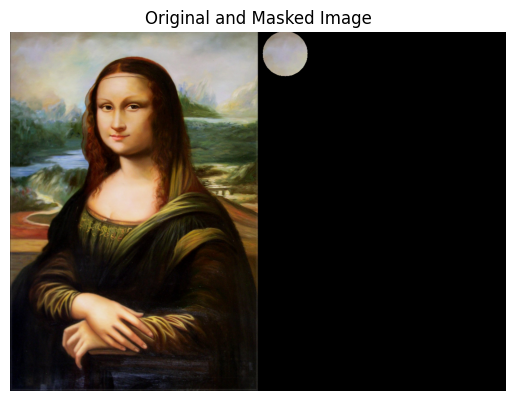

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Upload the image using Google Colab
from google.colab import files
uploaded = files.upload()

# Assuming the uploaded image is named 'R.jpg'
image_name = list(uploaded.keys())[0]

# Load the image
img = cv.imread('R.jpg')

# Check if the image is loaded correctly
if img is None:
    print("Error: Could not load image.")
else:
    # Resize the image
    img = cv.resize(img, None, fx=0.5, fy=0.5, interpolation=cv.INTER_CUBIC)

    # Create a circular mask
    mask = np.zeros(img.shape[:2], dtype='uint8')
    cv.circle(mask, (60, 50), 50, 255, -1)

    # Apply the mask
    masked = cv.bitwise_and(img, img, mask=mask)

    # Stack the original and masked images side by side
    img2 = np.hstack([img, masked])

    # Convert BGR to RGB for displaying with matplotlib
    img2 = cv.cvtColor(img2, cv.COLOR_BGR2RGB)

    # Display the image
    plt.imshow(img2)
    plt.title('Original and Masked Image')
    plt.axis('off')
    plt.show()


Saving R.jpg to R (2).jpg


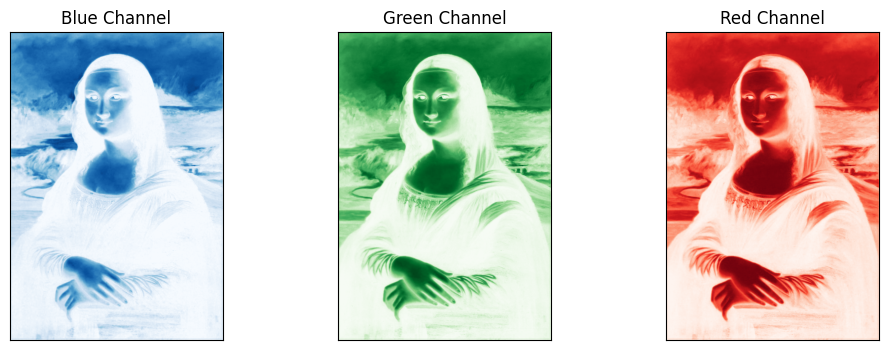

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Upload the image using Google Colab
from google.colab import files
uploaded = files.upload()

# Assuming the uploaded image is named 'image.jpg'
image_name = list(uploaded.keys())[0]

# Load the image
img = cv.imread(image_name)

# Check if the image is loaded correctly
if img is None:
    print("Error: Could not load image.")
else:
    # Split the image into its Blue, Green, and Red channels
    b, g, r = cv.split(img)

    # Create an array with the individual channels for display
    channels = [b, g, r]
    titles = ['Blue Channel', 'Green Channel', 'Red Channel']
    cmaps = ['Blues', 'Greens', 'Reds']

    plt.figure(figsize=(12, 4))

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.imshow(channels[i], cmap=cmaps[i])
        plt.title(titles[i])
        plt.xticks([]), plt.yticks([])

    plt.show()


Saving R.jpg to R (3).jpg


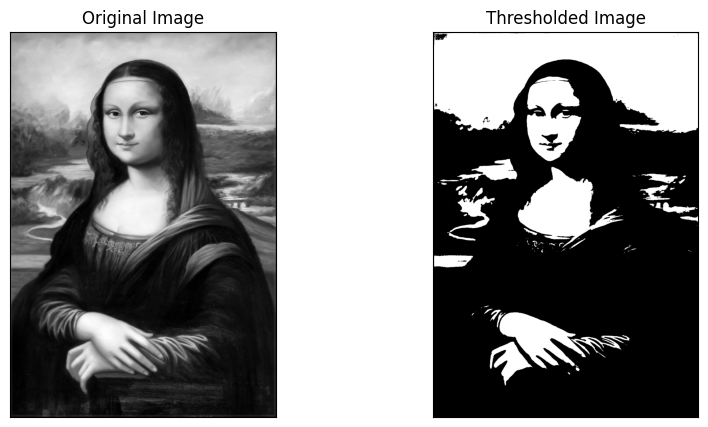

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# Upload the image using Google Colab
from google.colab import files
uploaded = files.upload()

# Assuming the uploaded image is named 'image.jpg'
image_name = list(uploaded.keys())[0]

# Load the image in grayscale mode
img = cv.imread(image_name, cv.IMREAD_GRAYSCALE)

# Check if the image is loaded correctly
if img is None:
    print("Error: Could not load image.")
else:
    # Apply simple thresholding
    threshold_value = 127
    max_value = 255
    _, binary_image = cv.threshold(img, threshold_value, max_value, cv.THRESH_BINARY)

    # Display the original and thresholded images
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.title('Original Image')
    plt.xticks([]), plt.yticks([])

    plt.subplot(1, 2, 2)
    plt.imshow(binary_image, cmap='gray')
    plt.title('Thresholded Image')
    plt.xticks([]), plt.yticks([])

    plt.show()


Saving OIP.jpg to OIP.jpg


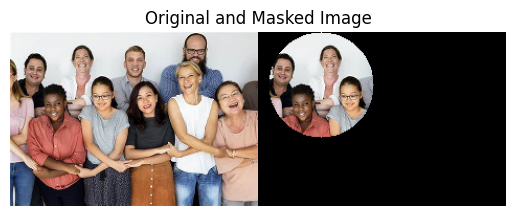

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

# Upload the image using Google Colab
uploaded = files.upload()

# Assuming the uploaded image is named 'image.jpg'
image_name = list(uploaded.keys())[0]

# Load the image
img = cv.imread(image_name)

# Check if the image is loaded correctly
if img is None:
    print("Error: Could not load image.")
else:
    # Resize the image
    img = cv.resize(img, None, fx=0.5, fy=0.5, interpolation=cv.INTER_CUBIC)

    # Create a circular mask
    mask = np.zeros(img.shape[:2], dtype='uint8')
    cv.circle(mask, (60, 50), 50, 255, -1)

    # Apply the mask
    masked = cv.bitwise_and(img, img, mask=mask)

    # Stack the original and masked images side by side
    img2 = np.hstack([img, masked])

    # Convert BGR to RGB for displaying with matplotlib
    img2 = cv.cvtColor(img2, cv.COLOR_BGR2RGB)

    # Display the image
    plt.imshow(img2)
    plt.title('Original and Masked Image')
    plt.axis('off')
    plt.show()


Error: Model files not found. Please upload the correct files.


In [ ]:
from google.colab import files

# Upload the model files
uploaded = files.upload()


Saving R.jpg to R (4).jpg


In [ ]:
import cv2 as cv
import numpy as np
import os

# Assuming the uploaded files are named 'deploy.prototxt' and 'mobilenet_iter_73000.caffemodel'
prototxt_path = 'deploy.prototxt'
model_path = 'mobilenet_iter_73000.caffemodel'

# Verify if the files exist
if not os.path.isfile(prototxt_path) or not os.path.isfile(model_path):
    print("Error: Model files not found. Please upload the correct files.")
else:
    # Load the pre-trained model and the class labels
    net = cv.dnn.readNetFromCaffe(prototxt_path, model_path)
    CLASSES = ["background", "aeroplane", "bicycle", "bird", "boat",
               "bottle", "bus", "car", "cat", "chair", "cow", "diningtable",
               "dog", "horse", "motorbike", "person", "pottedplant",
               "sheep", "sofa", "train", "tvmonitor"]

    # Load the input image
    image = cv.imread('R.jpg')
    (h, w) = image.shape[:2]

    # Prepare the image for detection
    blob = cv.dnn.blobFromImage(cv.resize(image, (300, 300)), 0.007843, (300, 300), 127.5)
    net.setInput(blob)
    detections = net.forward()

    # Loop over the detections
    for i in range(detections.shape[2]):
        confidence = detections[0, 0, i, 2]

        # Filter out weak detections
        if confidence > 0.2:
            idx = int(detections[0, 0, i, 1])
            box = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
            (startX, startY, endX, endY) = box.astype("int")

            # Draw the bounding box around the detected object
            label = "{}: {:.2f}%".format(CLASSES[idx], confidence * 100)
            cv.rectangle(image, (startX, startY), (endX, endY), (0, 255, 0), 2)
            y = startY - 15 if startY - 15 > 15 else startY + 15
            cv.putText(image, label, (startX, y), cv.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the output image
    cv.imshow('Object Detection', image)
    cv.waitKey(0)
    cv.destroyAllWindows()


Error: Model files not found. Please upload the correct files.


In [ ]:
import matplotlib.pyplot as plt


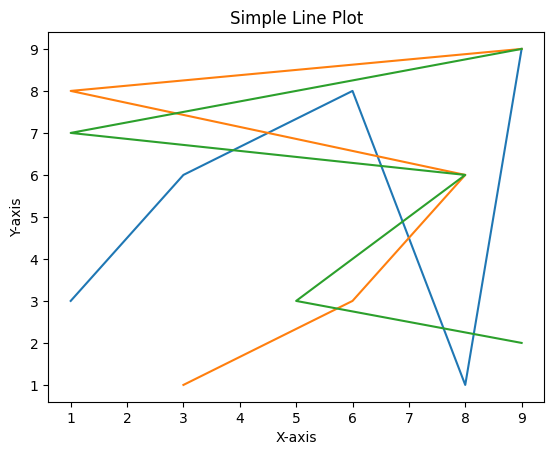

In [ ]:
# Data for plotting
x = [1, 2, 3, 4, 5]
y = [2, 3, 4, 7, 11]
# data for ploting
y=[3,6,8,1,9]
x=[1,3,6,8,9]
# data for ploting
z=[9,5,8,1,9]
q=[2,3,6,7,9]
# Create a line plot
plt.plot(x, y)
plt.plot(y,x)
plt.plot(z,q)

# Add a title and labels
plt.title('Simple Line Plot')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
# Display the plot
plt.show()

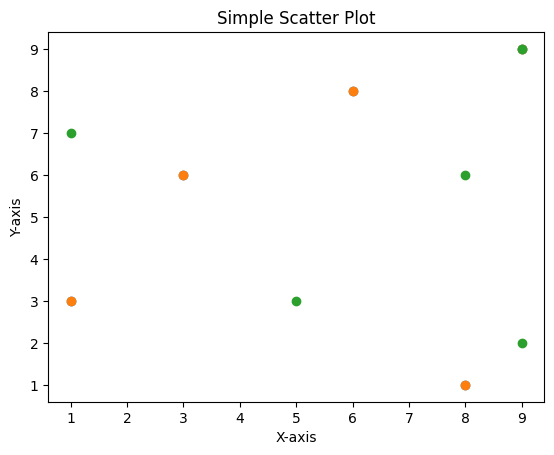

In [ ]:
# Data for plotting
x = [1, 2, 3, 4, 5]
y = [2, 3, 5, 7, 11]
# data for ploting
y=[3,6,8,1,9]
x=[1,3,6,8,9]
# data for ploting
z=[9,5,8,1,9]
q=[2,3,6,7,9]

# Create a scatter plot
plt.scatter(x, y)
plt.scatter(x, y)
plt.scatter(z, q)

# Add a title and labels
plt.title('Simple Scatter Plot')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')

# Display the plot
plt.show()


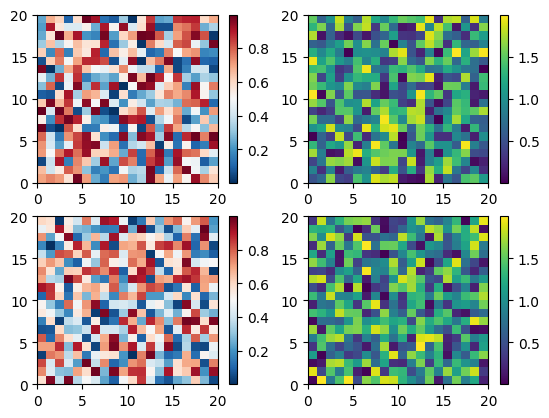

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Fixing random state for reproducibility
np.random.seed(19680801)

# Create a 2x2 grid of subplots
fig, axs = plt.subplots(2, 2)

# Define the colormaps to be used
cmaps = ['RdBu_r', 'viridis']

# Iterate over the columns and rows to populate the subplots
for col in range(2):
    for row in range(2):
        ax = axs[row, col]
        pcm = ax.pcolormesh(np.random.random((20, 20)) * (col + 1), cmap=cmaps[col])
        fig.colorbar(pcm, ax=ax)

# Display the plot
plt.show()


In [ ]:
from sklearn import datasets
iris = datasets.load_iris()
digits = datasets.load_digits()

In [ ]:
import pandas as pd
from google.colab import files
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Upload file
uploaded = files.upload()

# Load the uploaded file into a DataFrame
file_name = list(uploaded.keys())[0]
df = pd.read_csv(file_name)

print(df.head())


Saving employees.csv to employees.csv
   EMPLOYEE_ID FIRST_NAME  LAST_NAME     EMAIL  PHONE_NUMBER  HIRE_DATE  \
0        198.0     Donald   OConnell  DOCONNEL  650.507.9833  21-JUN-07   
1        199.0    Douglas      Grant    DGRANT  650.507.9844  13-JAN-08   
2        200.0   Jennifer     Whalen   JWHALEN  515.123.4444  17-SEP-03   
3        201.0    Michael  Hartstein  MHARTSTE  515.123.5555  17-FEB-04   
4          NaN        Pat        Fay      PFAY  603.123.6666  17-AUG-05   

     JOB_ID   SALARY COMMISSION_PCT MANAGER_ID  DEPARTMENT_ID  
0  SH_CLERK   2600.0             -         124           50.0  
1  SH_CLERK   2600.0             -         124           50.0  
2   AD_ASST   4400.0             -         101           10.0  
3    MK_MAN  13000.0             -         100           20.0  
4    MK_REP   6000.0             -         201           20.0  


Accuracy: 0.97
Confusion Matrix:
[[33  0  0  0  0  0  0  0  0  0]
 [ 0 28  0  0  0  0  0  0  0  0]
 [ 0  0 33  0  0  0  0  0  0  0]
 [ 0  0  0 33  0  1  0  0  0  0]
 [ 0  1  0  0 45  0  0  0  0  0]
 [ 0  0  0  0  0 44  1  0  0  2]
 [ 0  0  0  0  0  1 34  0  0  0]
 [ 0  0  0  0  0  0  0 33  0  1]
 [ 0  0  0  0  0  1  0  0 29  0]
 [ 0  0  0  1  0  0  0  0  1 38]]
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        33
           1       0.97      1.00      0.98        28
           2       1.00      1.00      1.00        33
           3       0.97      0.97      0.97        34
           4       1.00      0.98      0.99        46
           5       0.94      0.94      0.94        47
           6       0.97      0.97      0.97        35
           7       1.00      0.97      0.99        34
           8       0.97      0.97      0.97        30
           9       0.93      0.95      0.94        40

    accuracy     

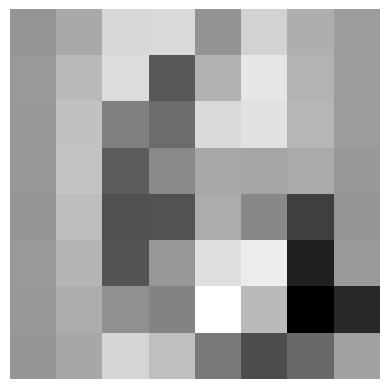

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Step 1: Import Libraries and Load Data
digits = datasets.load_digits()
X = digits.data
y = digits.target

# Step 2: Data Preprocessing
# Standardizing the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 3: Splitting the Data
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Step 4: Model Selection and Training
model = LogisticRegression(max_iter=10000)
model.fit(X_train, y_train)

# Step 5: Model Evaluation
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Accuracy: {accuracy:.2f}')
print('Confusion Matrix:')
print(conf_matrix)
print('Classification Report:')
print(class_report)

# Step 6: Making Predictions and Visualizing Results
def plot_digit(data):
    image = data.reshape(8, 8)
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.axis('off')
    plt.show()

# Predict a single image
index = 0
new_data = X_test[index].reshape(1, -1)
prediction = model.predict(new_data)
print(f'Predicted label: {prediction[0]}')

# Visualize the predicted image
plot_digit(X_test[index])


In [ ]:
import os
file_path = 'R.jpg'
if not os.path.exists(file_path):
    print(f"File {file_path} does not exist.")


File R.jpg does not exist.


In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Read the image using imread() function
image = cv2.imread('R.jpg')
if image is None:
    print("Image not found or failed to load.")

# Display the original BGR image if loaded successfully
if image is not None:
    cv2_imshow(image)

    # Using cv2.split() to split channels of colored image
    b, g, r = cv2.split(image)

    # Displaying Blue channel image
    cv2_imshow(b)

    # Displaying Green channel image
    cv2_imshow(g)

    # Displaying Red channel image
    cv2_imshow(r)


Image not found or failed to load.


In [ ]:
import pandas as pd
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Step 1: Import Libraries and Load Data
iris = load_iris()
X = iris.data
y = iris.target

# Step 2: Data Preprocessing
# Standardizing the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 3: Splitting the Data
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Step 4: Model Selection and Training
model = LogisticRegression(max_iter=10000)
model.fit(X_train, y_train)

# Step 5: Model Evaluation
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Accuracy: {accuracy:.2f}')
print('Confusion Matrix:')
print(conf_matrix)
print('Classification Report:')
print(class_report)

# Step 6: Making Predictions
new_data = [[5.1, 3.5, 1.4, 0.2]]  # Example data for a single flower
new_data_scaled = scaler.transform(new_data)
prediction = model.predict(new_data_scaled)
print(f'Prediction: {iris.target_names[prediction[0]]}')


Accuracy: 1.00
Confusion Matrix:
[[10  0  0]
 [ 0  9  0]
 [ 0  0 11]]
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        10
           1       1.00      1.00      1.00         9
           2       1.00      1.00      1.00        11

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30

Prediction: setosa


In [ ]:
import cv2
from google.colab import files
from google.colab.patches import cv2_imshow


In [ ]:
# Upload the image files
uploaded = files.upload()


Saving R.jpg to R.jpg


Please upload the logo image file.


Saving OIP.jpg to OIP.jpg
Saving R.jpg to R (2).jpg
Please upload the main image file.


Saving R.jpg to R (3).jpg


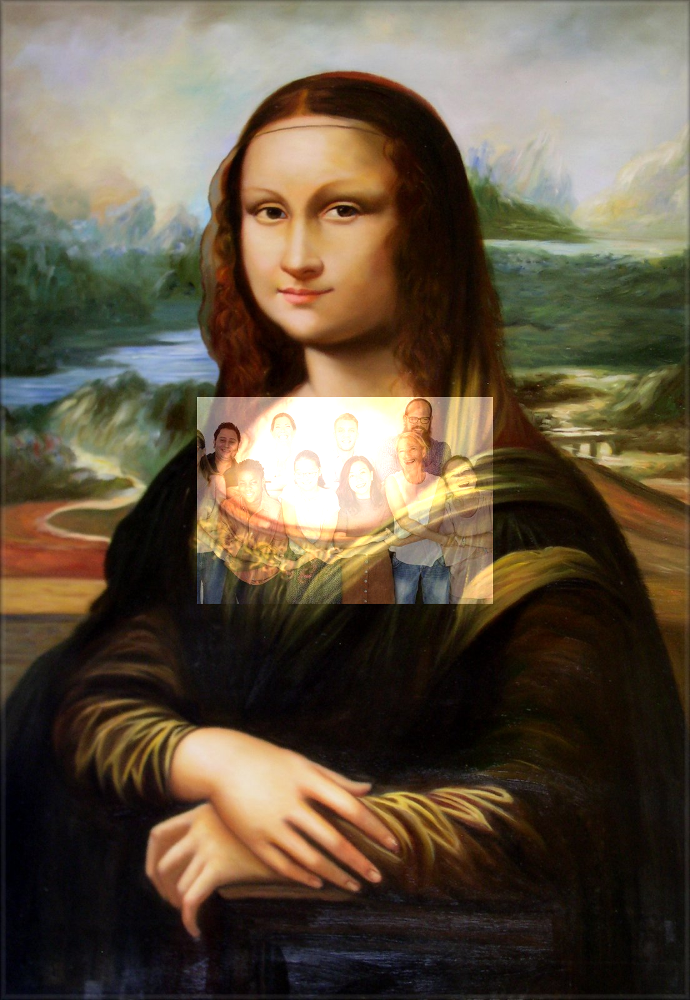

In [ ]:
import cv2
from google.colab import files
from google.colab.patches import cv2_imshow

# Function to upload a single file
def upload_file(prompt):
    print(prompt)
    uploaded = files.upload()
    filename = list(uploaded.keys())[0]
    return filename

# Upload the first image (logo)
logo_filename = upload_file("Please upload the logo image file.")
# Load the logo image
logo = cv2.imread(logo_filename)

# Check if the logo image is loaded successfully
if logo is None:
    print("Error: The logo image failed to load.")
else:
    # Upload the second image (main image)
    img_filename = upload_file("Please upload the main image file.")
    # Load the main image
    img = cv2.imread(img_filename)

    # Check if the main image is loaded successfully
    if img is None:
        print("Error: The main image failed to load.")
    else:
        # Calculate dimensions
        h_logo, w_logo, _ = logo.shape
        h_img, w_img, _ = img.shape

        # Calculate coordinates of the center
        center_y = int(h_img / 2)
        center_x = int(w_img / 2)

        # Calculate from top, bottom, right, and left
        top_y = center_y - int(h_logo / 2)
        left_x = center_x - int(w_logo / 2)
        bottom_y = top_y + h_logo
        right_x = left_x + w_logo

        # Add watermark to the image
        destination = img[top_y:bottom_y, left_x:right_x]
        result = cv2.addWeighted(destination, 1, logo, 0.5, 0)

        # Apply the watermark to the image
        img[top_y:bottom_y, left_x:right_x] = result

        # Save and display the watermarked image
        cv2.imwrite("watermarked.jpg", img)
        cv2_imshow(img)


In [ ]:
# importing required packages

import cv2

# reading the image
virat_img = cv2.imread('R.jpg')

# making border around image using copyMakeBorder
borderoutput = cv2.copyMakeBorder(
	virat_img, 20, 20, 20, 20, cv2.BORDER_CONSTANT, value=[255, 255, 0])

# showing the image with border
cv2.imwrite('output.png', borderoutput)


True

In [ ]:
import cv2
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from math import sqrt, exp


In [ ]:
#Custom Function for Image Plotting
def plot_figure(images: list, titles: list, rows: int, columns: int, fig_width=15, fig_height=7):
    fig = plt.figure(figsize=(fig_width, fig_height))
    count = 1
    for image, title in zip(images, titles):
        fig.add_subplot(rows, columns, count)
        count += 1
        plt.imshow(image, 'gray')
        plt.axis('off')
        plt.title(title)


#Custom Function to get Euclidean Distance
def distance(point1, point2):
    return sqrt((point1[0] - point2[0]) ** 2 + (point1[1] - point2[1]) ** 2)


In [ ]:
#Function to get low frequency component
#D0 is cutoff frequency
def gaussianLP(D0, imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2, cols/2)
    for i in range(rows):
        for j in range(cols):
            base[i, j] = np.exp(-distance((i, j), center)**2 / (2 * D0**2))
    return base


In [ ]:
#Function to get high frequency component
#D0 is cutoff frequency
def gaussianHP(D0, imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2, cols/2)
    for i in range(rows):
        for j in range(cols):
            base[i, j] = 1 - np.exp(-distance((i, j), center)**2 / (2 * D0**2))
    return base


In [ ]:
#Function to generate hybrid image
#D0 is cutoff frequency
def hybrid_images(image1, image2, D0 = 50):
    original1 = np.fft.fft2(image1)                          #Get the fourier of image1
    center1 = np.fft.fftshift(original1)                     #Apply Centre shifting
    LowPassCenter = center1 * gaussianLP(D0, image1.shape)   #Extract low frequency component
    LowPass = np.fft.ifftshift(LowPassCenter)
    inv_LowPass = np.fft.ifft2(LowPass)                         #Get image using Inverse FFT

    original2 = np.fft.fft2(image2)
    center2 = np.fft.fftshift(original2)
    HighPassCenter = center2 * gaussianHP(D0, image2.shape)  #Extract high frequency component
    HighPass = np.fft.ifftshift(HighPassCenter)
    inv_HighPass = np.fft.ifft2(HighPass)
    hybrid = np.abs(inv_LowPass) + np.abs(inv_HighPass)      #Generate the hybrid image
    return hybrid


Please upload the first image (A).


Saving C.jpg to C (1).jpg
Please upload the second image (B).


Saving p.jpg to p (1).jpg


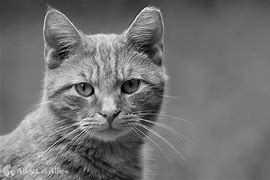

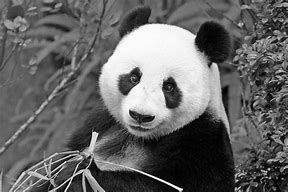

In [ ]:
import cv2
from google.colab import files
from google.colab.patches import cv2_imshow

# Function to upload a single file
def upload_file(prompt):
    print(prompt)
    uploaded = files.upload()
    filename = list(uploaded.keys())[0]
    return filename

# Upload the first image (A)
A_filename = upload_file("Please upload the first image (A).")
# Load the first image
A = cv2.imread(A_filename)

# Check if the first image is loaded successfully
if A is None:
    print("Error: The first image (A) failed to load.")
else:
    # Upload the second image (B)
    B_filename = upload_file("Please upload the second image (B).")
    # Load the second image
    B = cv2.imread(B_filename)

    # Check if the second image is loaded successfully
    if B is None:
        print("Error: The second image (B) failed to load.")
    else:
        # Convert both images to Grayscale to avoid any Color Channel Issue
        A_grayscale = cv2.cvtColor(A, cv2.COLOR_BGR2GRAY)
        B_grayscale = cv2.cvtColor(B, cv2.COLOR_BGR2GRAY)

        # Display the grayscale images
        cv2_imshow(A_grayscale)
        cv2_imshow(B_grayscale)


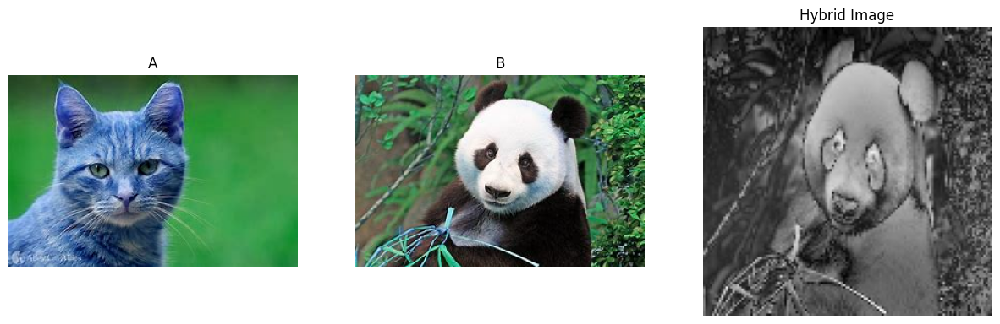

In [ ]:
# Load images
# Make sure to choose the same image format for both images (Ex- .png)
A = cv2.imread('C.jpg',cv2.IMREAD_COLOR) # high picture
B = cv2.imread('p.jpg',cv2.IMREAD_COLOR) # low picture

# Convert both images to Grayscale to avoid any Color Channel Issue
A_grayscale = cv2.cvtColor(A, cv2.COLOR_BGR2GRAY)
B_grayscale = cv2.cvtColor(B, cv2.COLOR_BGR2GRAY)

# Resize both images to 128x128 to avoid different image size issue
A_resized = cv2.resize(A_grayscale, (128, 128))
B_resized = cv2.resize(B_grayscale, (128, 128))

result = hybrid_images(A_resized,B_resized,1)

plot_figure([A,B,result], ['A','B','Hybrid Image'],1,3)


In [ ]:
a = ['-', '-', '-', 1, '-', '-', '-']
n = len(a) # length of the array

for i in range(2*n):
	# i is the index of the list a
	# i%n will have a value in range(0,n)
	# using slicing we can make the digit 1
	# appear to move across the list
	# this is similar to a cyclic list
	print(a[(i % n):]+a[:(i % n)])


['-', '-', '-', 1, '-', '-', '-']
['-', '-', 1, '-', '-', '-', '-']
['-', 1, '-', '-', '-', '-', '-']
[1, '-', '-', '-', '-', '-', '-']
['-', '-', '-', '-', '-', '-', 1]
['-', '-', '-', '-', '-', 1, '-']
['-', '-', '-', '-', 1, '-', '-']
['-', '-', '-', 1, '-', '-', '-']
['-', '-', 1, '-', '-', '-', '-']
['-', 1, '-', '-', '-', '-', '-']
[1, '-', '-', '-', '-', '-', '-']
['-', '-', '-', '-', '-', '-', 1]
['-', '-', '-', '-', '-', 1, '-']
['-', '-', '-', '-', 1, '-', '-']


Saving C.jpg to C (4).jpg


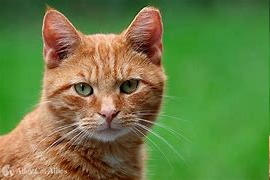

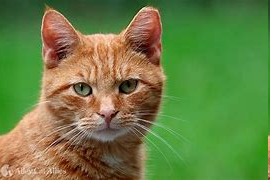

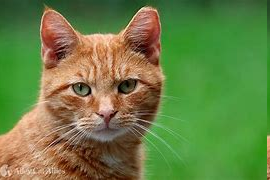

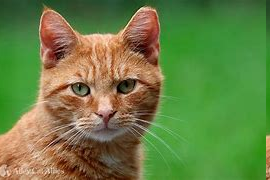

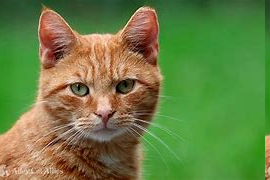

...

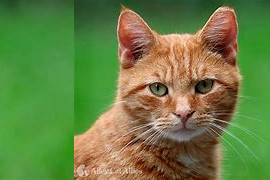

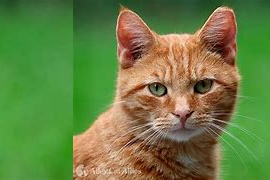

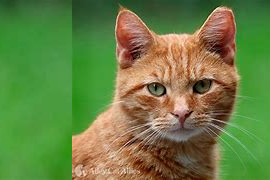

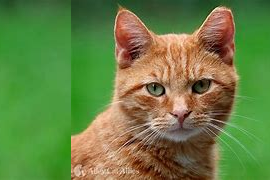

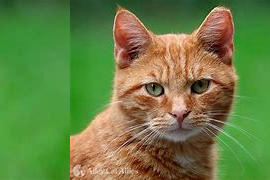

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Upload the image file
from google.colab import files
uploaded = files.upload()

# Load the image (ensure the uploaded filename matches)
img = cv2.imread(list(uploaded.keys())[0])

# Check if the image is loaded successfully
if img is None:
    print("Error: The image failed to load.")
else:
    height, width, c = img.shape

    i = 0
    max_iterations = 200  # Adjust the number of iterations as needed

    while i < max_iterations:
        i += 1

        # Divide the image into left and right parts
        l = img[:, :(i % width)]
        r = img[:, (i % width):]

        img1 = np.hstack((r, l))

        # Display the image
        cv2_imshow(img1)

        # Wait a short period to visualize the animation
        cv2.waitKey(50)  # Adjust the delay as needed

        # Break the loop if 'q' is pressed
        if cv2.waitKey(1) == ord('q'):
            break


Please upload the logo image file.


Saving C.jpg to C (2).jpg
Please upload the main image file.


Saving p.jpg to p (2).jpg


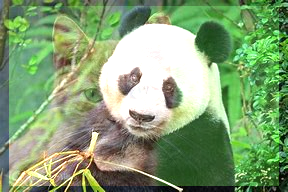

In [ ]:
import cv2
from google.colab import files
from google.colab.patches import cv2_imshow

# Function to upload a single file
def upload_file(prompt):
    print(prompt)
    uploaded = files.upload()
    filename = list(uploaded.keys())[0]
    return filename

# Upload the first image (logo)
logo_filename = upload_file("Please upload the logo image file.")
# Load the logo image
logo = cv2.imread(logo_filename)

# Check if the logo image is loaded successfully
if logo is None:
    print("Error: The logo image failed to load.")
else:
    # Upload the second image (main image)
    img_filename = upload_file("Please upload the main image file.")
    # Load the main image
    img = cv2.imread(img_filename)

    # Check if the main image is loaded successfully
    if img is None:
        print("Error: The main image failed to load.")
    else:
        # Calculate dimensions
        h_logo, w_logo, _ = logo.shape
        h_img, w_img, _ = img.shape

        # Calculate coordinates of the center
        center_y = int(h_img / 2)
        center_x = int(w_img / 2)

        # Calculate from top, bottom, right, and left
        top_y = center_y - int(h_logo / 2)
        left_x = center_x - int(w_logo / 2)
        bottom_y = top_y + h_logo
        right_x = left_x + w_logo

        # Add watermark to the image
        destination = img[top_y:bottom_y, left_x:right_x]
        result = cv2.addWeighted(destination, 1, logo, 0.5, 0)

        # Apply the watermark to the image
        img[top_y:bottom_y, left_x:right_x] = result

        # Save and display the watermarked image
        cv2.imwrite("watermarked.jpg", img)
        cv2_imshow(img)


In [ ]:
import cv2
import requests
import matplotlib.pyplot as plt
from deepface import DeepFace


25-02-27 11:19:35 - Directory /root/.deepface has been created
25-02-27 11:19:35 - Directory /root/.deepface/weights has been created


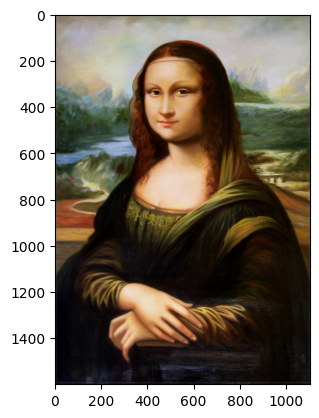

In [ ]:
# read the image from location and store
# it in the form of an array
img = cv2.imread("R.jpg")
# call imshow() using plt object and display the image
plt.imshow(img[:, :, :: -1])
# ensures that the image is displayed
plt.show()


In [ ]:
# storing the dictionary of emotions in result
result = DeepFace.analyze(img, actions = ['emotion'])
# print result
print(result)


25-02-27 11:20:38 - facial_expression_model_weights.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/facial_expression_model_weights.h5
To: /root/.deepface/weights/facial_expression_model_weights.h5
100%|██████████| 5.98M/5.98M [00:00<00:00, 17.3MB/s]


[{'emotion': {'angry': 0.1410387074821417, 'disgust': 4.887559745701948e-09, 'fear': 0.00223690126094658, 'happy': 0.24040193798553575, 'sad': 0.5673240277066247, 'surprise': 0.0005708459297338403, 'neutral': 99.04842967083631}, 'dominant_emotion': 'neutral', 'region': {'x': 332, 'y': 216, 'w': 316, 'h': 316, 'left_eye': (536, 336), 'right_eye': (433, 339)}, 'face_confidence': 0.91}]


In [ ]:
# extracting emotion with highest percentage
query = str(max(zip(result[0]['emotion'].values(),
					result[0]['emotion'].keys()))[1])
print(query)


neutral


In [ ]:
# Spotify API URL is called using Rapid API
url = "https://spotify81.p.rapidapi.com/search"
# querystring is passed to spotify API
# query is the string we search for
querystring = {"q": f"{query}", "type": "multi",
			"offset": "0", "limit": "10",
			"numberOfTopResults": "5"}
# headers contain the API key and API host
headers = {
	"X-RapidAPI-Key": "<YOUR_API_KEY>",
	"X-RapidAPI-Host": "spotify81.p.rapidapi.com"
}
# we use the requests library to sent a HTTP
# GET request to the specified URL
response = requests.get(url, headers=headers,
						params=querystring)
# Our response has 10 results, we list
# them down using for loop
for i in range(10):
	print('song name:', response.json()['tracks']
		[i]['data']['name'],
		'\nalbum name:',
		response.json()['tracks'][i]
		['data']['albumOfTrack']['name'], '\n')


KeyError: 'tracks'

In [ ]:
!pip install -q deepface


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.6/108.6 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 29.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 41.3 MB/s eta 0:00:00


Saving smoke skeleton.jpg to smoke skeleton.jpg


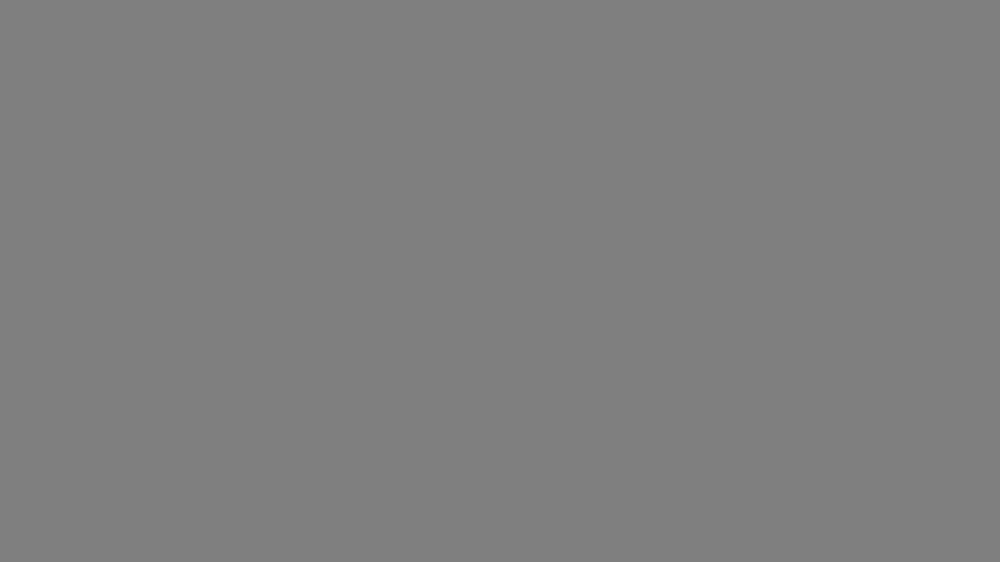

In [ ]:
from google.colab import files
import cv2
import numpy as np
import IPython.display as display
from google.colab.patches import cv2_imshow

# Upload video manually
uploaded = files.upload()

# Get the filename
video_path = list(uploaded.keys())[0]

# Open the video file
cap = cv2.VideoCapture(video_path)

# Initialize background subtractor
fgbg = cv2.createBackgroundSubtractorMOG2(history=500, varThreshold=50, detectShadows=True)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Apply background subtraction
    fgmask = fgbg.apply(frame)

    # Show frame in Colab
    cv2_imshow(fgmask)

    # Press 'q' to exit manually (only for local)
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 82s 51ms/step - accuracy: 0.3729 - loss: 1.7105 - val_accuracy: 0.5679 - val_loss: 1.2303
Epoch 2/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 79s 49ms/step - accuracy: 0.5964 - loss: 1.1489 - val_accuracy: 0.6221 - val_loss: 1.0755
Epoch 3/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 76s 49ms/step - accuracy: 0.6626 - loss: 0.9568 - val_accuracy: 0.6735 - val_loss: 0.9271
Epoch 4/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 82s 49ms/step - accuracy: 0.7093 - loss: 0.8365 - val_accuracy: 0.6862 - val_loss: 0.9069
Epoch 5/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 75s 48ms/step - accuracy: 0.7453 - loss: 0.7240 - val_accuracy: 0.7027 - val_loss: 0.8604
Epoch 6/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 82s 48ms/step - accuracy: 0.7701 - loss: 0.6516 - val_accuracy: 0.7138 - val_loss: 0.8352
Epoch 7/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 76s 48ms/step - accuracy: 0.7990 - loss: 0.5683 - val_accuracy: 0.7121 - val_loss: 0.8677
Epoch 8/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 83s 49ms/step - accuracy: 0.8183 -

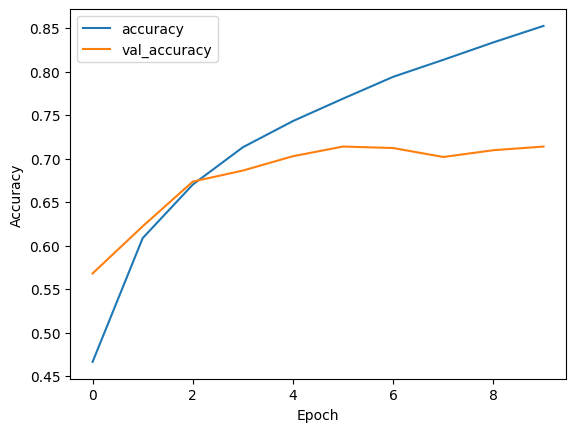

In [ ]:
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import numpy as np

# Load CIFAR-10 dataset
(x_train, y_train), (x_test, y_test) = keras.datasets.cifar10.load_data()

# Normalize pixel values to be between 0 and 1
x_train, x_test = x_train / 255.0, x_test / 255.0

# Define the CNN model
model = keras.Sequential([
    keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(32, 32, 3)),
    keras.layers.MaxPooling2D((2,2)),
    keras.layers.Conv2D(64, (3,3), activation='relu'),
    keras.layers.MaxPooling2D((2,2)),
    keras.layers.Conv2D(128, (3,3), activation='relu'),
    keras.layers.Flatten(),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(10, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model.fit(x_train, y_train, epochs=10, validation_data=(x_test, y_test))

# Evaluate the model
test_loss, test_acc = model.evaluate(x_test, y_test, verbose=2)
print(f'\nTest accuracy: {test_acc:.4f}')

# Plot training history
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [ ]:
import torchvision.transforms as transforms
from PIL import Image
import os

# Set the image path
image_path = "R.jpg"  # Change this to your actual image file

# Check if the file exists
if not os.path.exists(image_path):
    print(f"❌ Error: File '{image_path}' not found! Please check the path.")
else:
    # Load image using PIL
    image = Image.open(image_path).convert("RGB")  # Ensure it's in RGB mode

    # Print confirmation
    print("✅ Image successfully loaded!")
    print("Image Format:", image.format)
    print("Image Size:", image.size)

    # Show the image
    image.show()  # Opens the image in the default viewer


✅ Image successfully loaded!
Image Format: None
Image Size: (1104, 1600)


In [ ]:
transform = transforms.ToTensor()  # Convert to tensor
image_tensor = transform(image)

print("Tensor Shape:", image_tensor.shape)  # Output: (C, H, W)


Tensor Shape: torch.Size([3, 1600, 1104])


In [ ]:
normalize_transform = transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
image_normalized = normalize_transform(image_tensor)

print("✅ Image normalized successfully!")


✅ Image normalized successfully!


In [ ]:
from torchvision.transforms.functional import to_pil_image

image_pil = to_pil_image(image_tensor)  # Convert tensor to image
image_pil.show()


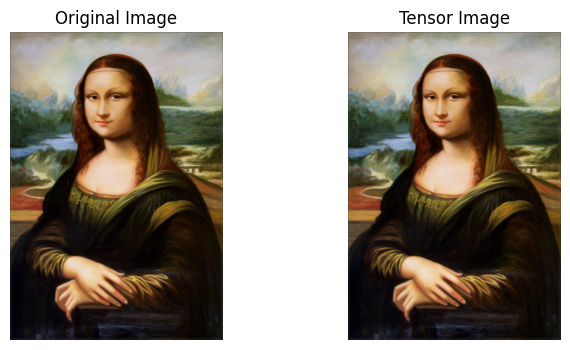

In [ ]:
import matplotlib.pyplot as plt

# Convert tensor to NumPy format for visualization
unnormalized_image = image_tensor.permute(1, 2, 0)  # Convert from (C, H, W) to (H, W, C)

plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(image)
plt.axis("off")
plt.title("Original Image")

plt.subplot(1, 2, 2)
plt.imshow(unnormalized_image.numpy())  # Convert tensor to NumPy
plt.axis("off")
plt.title("Tensor Image")

plt.show()


In [ ]:
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt

# Load the image
image_path = "image.jpg"  # Replace with your actual image path
image = Image.open(image_path).convert("RGB")  # Ensure it's in RGB mode

# Apply transformations
transform_advanced = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize
    transforms.CenterCrop(200),  # Center crop
    transforms.RandomRotation(45),  # Rotate by 45 degrees
    transforms.ToTensor()  # Convert to tensor
])

# Apply the transformation
image_transformed = transform_advanced(image)

# Convert back to PIL image
from torchvision.transforms.functional import to_pil_image
image_pil = to_pil_image(image_transformed)

# Show the transformed image
plt.imshow(image_pil)
plt.axis("off")
plt.title("Transformed Image")
plt.show()


FileNotFoundError: [Errno 2] No such file or directory: 'image.jpg'

In [ ]:
import torch

N,D = 3,5
x=torch.rand((N,D),requires_grad=True)
y=torch.rand((N,D),requires_grad=True)
z=torch.rand((N,D),requires_grad=True)
a=x+y
b=a+z
c=torch.sum(b)
c.backward()
print(x.grad)
print(y.grad)
print(z.grad)

tensor([[1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1.]])
tensor([[1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1.]])
tensor([[1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1.]])


In [ ]:
pip install torch torchvision matplotlib


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 89.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 74.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 44.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 82.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 9.91M/9.91M [00:01<00:00, 5.49MB/s]


Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 28.9k/28.9k [00:00<00:00, 160kB/s]


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 1.65M/1.65M [00:01<00:00, 1.51MB/s]


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 4.54k/4.54k [00:00<00:00, 6.61MB/s]


Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw

Epoch 1, Loss: 0.13633643830120565
Epoch 2, Loss: 0.04219297607381983
Epoch 3, Loss: 0.028721370773380234
Epoch 4, Loss: 0.021927753226430893
Epoch 5, Loss: 0.01527999782773477
✅ Accuracy: 99.18%


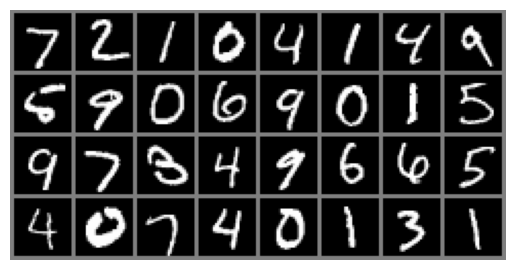

Predicted labels: [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4 9 6 6 5 4 0 7 4 0 1 3 1]


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt

# ✅ Step 1: Load and Preprocess Data
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

trainset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=32, shuffle=True)

testset = torchvision.datasets.MNIST(root='./data', train=False, download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=32, shuffle=False)

# ✅ Step 2: Define the CNN Model
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.fc1 = nn.Linear(64 * 7 * 7, 128)  # MNIST image size reduced to 7x7 after conv and pooling
        self.fc2 = nn.Linear(128, 10)  # 10 classes for digits 0-9

    def forward(self, x):
        x = self.pool(torch.relu(self.conv1(x)))
        x = self.pool(torch.relu(self.conv2(x)))
        x = torch.flatten(x, 1)
        x = torch.relu(self.fc1(x))
        x = self.fc2(x)
        return x

# ✅ Step 3: Train the Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = CNN().to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

epochs = 5
for epoch in range(epochs):
    running_loss = 0.0
    for images, labels in trainloader:
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

    print(f"Epoch {epoch+1}, Loss: {running_loss/len(trainloader)}")

# ✅ Step 4: Evaluate the Model
correct = 0
total = 0
with torch.no_grad():
    for images, labels in testloader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f"✅ Accuracy: {100 * correct / total:.2f}%")

# ✅ Step 5: Test on Sample Images
import numpy as np

def imshow(img):
    img = img / 2 + 0.5  # Unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)), cmap="gray")
    plt.axis("off")
    plt.show()

# Get a batch of test images
dataiter = iter(testloader)
images, labels = next(dataiter)

# Predict and show images
images, labels = images.to(device), labels.to(device)
outputs = model(images)
_, predicted = torch.max(outputs, 1)

# Show images
imshow(torchvision.utils.make_grid(images.cpu()))

# Print predictions
print("Predicted labels:", predicted.cpu().numpy())


In [ ]:
!pip install torch torchvision numpy opencv-python matplotlib
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt


Cloning into 'yolov5'...
remote: Enumerating objects: 17270, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 17270 (delta 0), reused 0 (delta 0), pack-reused 17269 (from 2)
Receiving objects: 100% (17270/17270), 16.10 MiB | 14.48 MiB/s, done.
Resolving deltas: 100% (11855/11855), done.
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 932.9/932.9 kB 15.6 MB/s eta 0:00:00


/usr/local/lib/python3.11/dist-packages/torch/hub.py:330: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


YOLOv5 🚀 2025-3-12 Python-3.11.11 torch-2.5.1+cu124 CPU

100%|██████████| 14.1M/14.1M [00:00<00:00, 29.8MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


Saving O.jpg to O.jpg


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


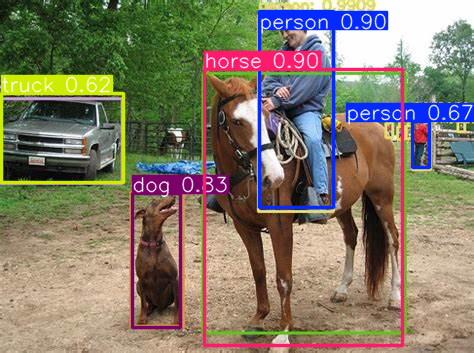

         xmin        ymin        xmax        ymax  confidence  class    name
0  204.701553   69.061371  402.031342  345.865234    0.904727     17   horse
1  259.215210   11.970421  333.057190  207.209702    0.898261      0  person
2  132.424454  193.794754  180.925705  327.159973    0.826104     16     dog
3  412.922455  121.386238  429.204010  167.141510    0.672791      0  person
4    1.583242   93.725395  123.271759  182.287064    0.616783      7   truck


In [ ]:
import torch
from PIL import Image
import matplotlib.pyplot as plt

# Load the YOLOv5 model (pre-trained on COCO dataset)
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

# Upload an image in Colab
from google.colab import files
uploaded = files.upload()  # Upload an image manually

image_path = list(uploaded.keys())[0]  # Get uploaded image filename
image = Image.open(image_path)

# Perform inference (object detection)
results = model(image)

# Show the detected objects
results.show()

# Print detection details (bounding box, confidence, class, etc.)
print(results.pandas().xyxy[0])


In [ ]:
!wget -O video.mp4 "https://sample-videos.com/video123/mp4/720/big_buck_bunny_720p_1mb.mp4"  # Download sample video

import cv2

# Load video
video_path = "video.mp4"
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Perform object detection
    results = model(frame)
    detected_frame = results.render()[0]  # Get the frame with bounding boxes

    # Show frame (Colab doesn't support cv2.imshow, so we save frames instead)
    cv2.imwrite("frame.jpg", detected_frame)
    from IPython.display import display
    display(Image.open("frame.jpg"))

cap.release()


--2025-03-12 08:48:01--  https://sample-videos.com/video123/mp4/720/big_buck_bunny_720p_1mb.mp4
Resolving sample-videos.com (sample-videos.com)... 103.145.51.95
Connecting to sample-videos.com (sample-videos.com)|103.145.51.95|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2025-03-12 08:48:01 ERROR 404: Not Found.



In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Generate synthetic data for training
def generate_data(num_samples):
    X = np.random.uniform(low=0, high=180, size=(num_samples, 3))  # Joint angles (base, shoulder, elbow)
    Y = np.sin(np.radians(X))  # Simplified target: sin of the joint angles (for demonstration purposes)
    return X, Y

# Create a simple neural network model
def build_model():
    model = keras.Sequential([
        layers.Dense(64, activation='relu', input_shape=(3,)),
        layers.Dense(64, activation='relu'),
        layers.Dense(3)  # Output: optimized joint angles
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

# Generate training data
X_train, Y_train = generate_data(num_samples=1000)

# Build and train the model
model = build_model()
model.fit(X_train, Y_train, epochs=50, batch_size=32)

# Predict optimized joint angles for a new set of angles
new_joint_angles = np.array([[30, 45, 60]])  # Example input angles
optimized_angles = model.predict(new_joint_angles)
print("Optimized Joint Angles:", optimized_angles)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 144.2810
Epoch 2/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 3.3844
Epoch 3/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.9198
Epoch 4/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.5608
Epoch 5/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.4326
Epoch 6/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.3494
Epoch 7/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.3486
Epoch 8/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.2772
Epoch 9/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.2463
Epoch 10/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.2588
Epoch 11/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.2195
Epoch 12/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.1910
Epoch 13/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.1939
Epoch 14/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.1885
Epoch 15/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.2092
Epoch 16/50
3

In [ ]:
"Create a detailed 3D CAD model of a humanoid robot body, with a head containing sensors and cameras, a torso housing control units, arms with multiple joints and fingers for dexterity, and legs designed for walking and balancing. The design should resemble human proportions and be aesthetically pleasing."


'Create a detailed 3D CAD model of a humanoid robot body, with a head containing sensors and cameras, a torso housing control units, arms with multiple joints and fingers for dexterity, and legs designed for walking and balancing. The design should resemble human proportions and be aesthetically pleasing.'

In [ ]:
pip install pybullet


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.2/103.2 MB 7.1 MB/s eta 0:00:00


In [ ]:
!pip install transformers
!pip install torch


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 59.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 45.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 35.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 33.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
from transformers import AutoModelForCausalLM, AutoTokenizer
import torch

# Load pre-trained model and tokenizer
model_name = "gpt2"
model = AutoModelForCausalLM.from_pretrained(model_name)
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Function to generate a response
def generate_response(prompt):
    inputs = tokenizer.encode(prompt, return_tensors="pt")
    outputs = model.generate(inputs, max_length=50, num_return_sequences=1, do_sample=True, top_k=50)
    response = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return response

# Chat loop
while True:
    user_input = input("You: ")
    if user_input.lower() in ['exit', 'quit']:
        break
    response = generate_response(user_input)
    print("Bot:", response)


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/548M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

You: hello


The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


Bot: hello by the sea. They'll come back later. On the ship's second day when they are ready to leave (which time is on a late summer summer night for the rest of the people), the captain (Niko Kami) gives him
You: write some code


The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


Bot: write some code to get rid of this annoying bug…and get yourself at AIM's headquarters!

I've used AIM before and worked with the best developers in the industry, so I feel they've been extremely fair.
You: pad-token id


The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


Bot: pad-token id="1" > <input type="checkbox" value="<<<"><i.keywords [0].text></i></i></i></i></input type="checkbox> <input type="checkbox"
You: exit


In [ ]:
!cat /var/log/colab-jupyter.log


cat: /var/log/colab-jupyter.log: No such file or directory


In [ ]:
!pip install torch torchvision numpy opencv-python gym pygame matplotlib tensorflow keras stable-baselines3


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.9/183.9 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 958.1/958.1 kB 33.7 MB/s eta 0:00:00
  Attempting uninstall: gymnasium
    Found existing installation: gymnasium 1.1.1
    Uninstalling gymnasium-1.1.1:
      Successfully uninstalled gymnasium-1.1.1


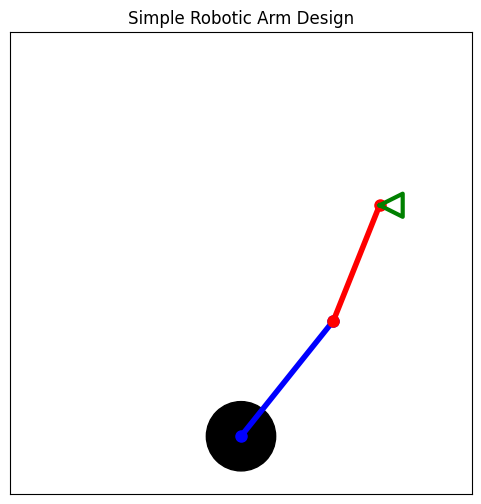

In [ ]:

import matplotlib.pyplot as plt
import numpy as np

def draw_robotic_arm():
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlim(-2, 2)
    ax.set_ylim(-2, 2)
    ax.set_aspect('equal')

    # Base of the robot
    base = plt.Circle((0, -1.5), 0.3, color='black')
    ax.add_patch(base)

    # Lower arm
    lower_arm_x = [0, 0.8]
    lower_arm_y = [-1.5, -0.5]
    ax.plot(lower_arm_x, lower_arm_y, 'bo-', markersize=8, linewidth=4)

    # Upper arm
    upper_arm_x = [0.8, 1.2]
    upper_arm_y = [-0.5, 0.5]
    ax.plot(upper_arm_x, upper_arm_y, 'ro-', markersize=8, linewidth=4)

    # End effector (gripper)
    gripper_x = [1.2, 1.4, 1.4, 1.2]
    gripper_y = [0.5, 0.6, 0.4, 0.5]
    ax.plot(gripper_x, gripper_y, 'g-', linewidth=3)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title("Simple Robotic Arm Design")

    plt.show()

# Call the function to draw the robotic arm
draw_robotic_arm()


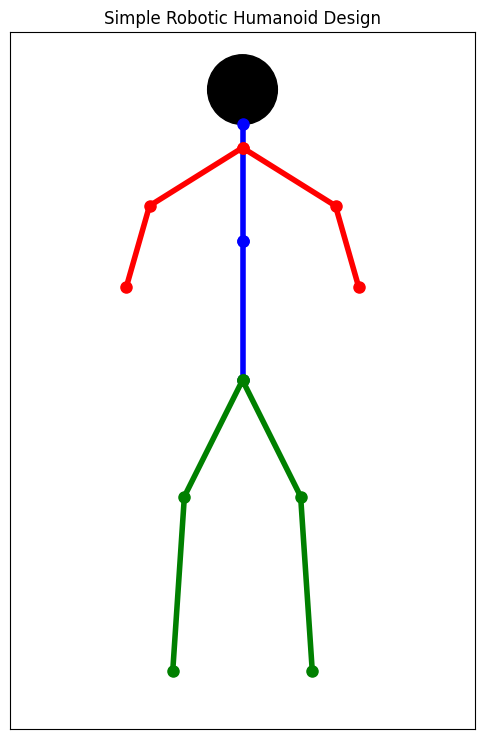

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def draw_robotic_humanoid():
    fig, ax = plt.subplots(figsize=(6, 10))
    ax.set_xlim(-2, 2)
    ax.set_ylim(-3, 3)
    ax.set_aspect('equal')

    # Head
    head = plt.Circle((0, 2.5), 0.3, color='black')
    ax.add_patch(head)

    # Body
    body_x = [0, 0]
    body_y = [2.2, 1.2]
    ax.plot(body_x, body_y, 'bo-', markersize=8, linewidth=4)

    # Left arm
    left_arm_x = [0, -0.8, -1.0]
    left_arm_y = [2.0, 1.5, 0.8]
    ax.plot(left_arm_x, left_arm_y, 'ro-', markersize=8, linewidth=4)

    # Right arm
    right_arm_x = [0, 0.8, 1.0]
    right_arm_y = [2.0, 1.5, 0.8]
    ax.plot(right_arm_x, right_arm_y, 'ro-', markersize=8, linewidth=4)

    # Lower body
    lower_body_x = [0, 0]
    lower_body_y = [1.2, 0]
    ax.plot(lower_body_x, lower_body_y, 'bo-', markersize=8, linewidth=4)

    # Left leg
    left_leg_x = [0, -0.5, -0.6]
    left_leg_y = [0, -1, -2.5]
    ax.plot(left_leg_x, left_leg_y, 'go-', markersize=8, linewidth=4)

    # Right leg
    right_leg_x = [0, 0.5, 0.6]
    right_leg_y = [0, -1, -2.5]
    ax.plot(right_leg_x, right_leg_y, 'go-', markersize=8, linewidth=4)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title("Simple Robotic Humanoid Design")

    plt.show()

# Call the function to draw the robotic humanoid
draw_robotic_humanoid()


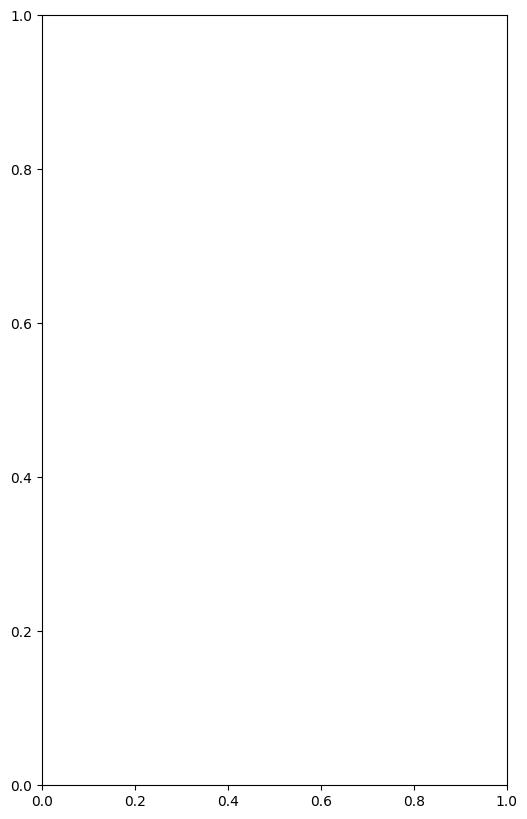

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation

def update(frame):
    ax.clear()
    ax.set_xlim(-2, 2)
    ax.set_ylim(-3, 3)
    ax.set_aspect('equal')

    # Head
    head = plt.Circle((0, 2.5), 0.3, color='black')
    ax.add_patch(head)

    # Body
    body_x = [0, 0]
    body_y = [2.2, 1.2]
    ax.plot(body_x, body_y, 'bo-', markersize=8, linewidth=4)

    # Moving left arm
    angle = np.sin(frame / 10) * 0.5
    left_arm_x = [0, -0.8 * np.cos(angle), -1.0 * np.cos(angle)]
    left_arm_y = [2.0, 1.5 - 0.5 * np.sin(angle), 0.8 - 0.5 * np.sin(angle)]
    ax.plot(left_arm_x, left_arm_y, 'ro-', markersize=8, linewidth=4)

    # Moving right arm
    right_arm_x = [0, 0.8 * np.cos(angle), 1.0 * np.cos(angle)]
    right_arm_y = [2.0, 1.5 - 0.5 * np.sin(angle), 0.8 - 0.5 * np.sin(angle)]
    ax.plot(right_arm_x, right_arm_y, 'ro-', markersize=8, linewidth=4)

    # Lower body
    lower_body_x = [0, 0]
    lower_body_y = [1.2, 0]
    ax.plot(lower_body_x, lower_body_y, 'bo-', markersize=8, linewidth=4)

    # Moving left leg
    leg_angle = np.sin(frame / 10) * 0.3
    left_leg_x = [0, -0.5 * np.cos(leg_angle), -0.6 * np.cos(leg_angle)]
    left_leg_y = [0, -1 + 0.5 * np.sin(leg_angle), -2.5 + 0.5 * np.sin(leg_angle)]
    ax.plot(left_leg_x, left_leg_y, 'go-', markersize=8, linewidth=4)

    # Moving right leg
    right_leg_x = [0, 0.5 * np.cos(leg_angle), 0.6 * np.cos(leg_angle)]
    right_leg_y = [0, -1 - 0.5 * np.sin(leg_angle), -2.5 - 0.5 * np.sin(leg_angle)]
    ax.plot(right_leg_x, right_leg_y, 'go-', markersize=8, linewidth=4)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title("Animated Robotic Humanoid")

# Set up the figure and animation
fig, ax = plt.subplots(figsize=(6, 10))
ani = animation.FuncAnimation(fig, update, frames=100, interval=50)
plt.show()

In [ ]:
pip install matplotlib numpy


In [ ]:
pip install matplotlib


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(6, 10))

def update(frame):
    ax.clear()
    ax.set_xlim(-2, 2)
    ax.set_ylim(-3, 3)
    ax.set_aspect('equal')

    # Head
    head = plt.Circle((0, 2.5), 0.3, color='black')
    ax.add_patch(head)

    # Body
    body_x = [0, 0]
    body_y = [2.2, 1.2]
    ax.plot(body_x, body_y, 'bo-', markersize=8, linewidth=4)

    # Moving left arm
    angle = np.sin(frame / 10) * 0.5
    left_arm_x = [0, -0.8 * np.cos(angle), -1.0 * np.cos(angle)]
    left_arm_y = [2.0, 1.5 - 0.5 * np.sin(angle), 0.8 - 0.5 * np.sin(angle)]
    ax.plot(left_arm_x, left_arm_y, 'ro-', markersize=8, linewidth=4)

    # Moving right arm
    right_arm_x = [0, 0.8 * np.cos(angle), 1.0 * np.cos(angle)]
    right_arm_y = [2.0, 1.5 - 0.5 * np.sin(angle), 0.8 - 0.5 * np.sin(angle)]
    ax.plot(right_arm_x, right_arm_y, 'ro-', markersize=8, linewidth=4)

    # Lower body
    lower_body_x = [0, 0]
    lower_body_y = [1.2, 0]
    ax.plot(lower_body_x, lower_body_y, 'bo-', markersize=8, linewidth=4)

    # Moving left leg
    leg_angle = np.sin(frame / 10) * 0.3
    left_leg_x = [0, -0.5 * np.cos(leg_angle), -0.6 * np.cos(leg_angle)]
    left_leg_y = [0, -1 + 0.5 * np.sin(leg_angle), -2.5 + 0.5 * np.sin(leg_angle)]
    ax.plot(left_leg_x, left_leg_y, 'go-', markersize=8, linewidth=4)

    # Moving right leg
    right_leg_x = [0, 0.5 * np.cos(leg_angle), 0.6 * np.cos(leg_angle)]
    right_leg_y = [0, -1 - 0.5 * np.sin(leg_angle), -2.5 - 0.5 * np.sin(leg_angle)]
    ax.plot(right_leg_x, right_leg_y, 'go-', markersize=8, linewidth=4)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title("Animated Robotic Humanoid")

ani = animation.FuncAnimation(fig, update, frames=100, interval=50)

# Add this line to keep the animation running
plt.show(block=True)


<IPython.core.display.Javascript object>

In [ ]:
pip install tk


In [ ]:
pip install ffmpeg


  Preparing metadata (setup.py) ... done
  Created wheel for ffmpeg: filename=ffmpeg-1.4-py3-none-any.whl size=6082 sha256=6ff8bf24cfb8490194177c97aa956640b21a932131764654fdd21ddb5553dc22
  Stored in directory: /root/.cache/pip/wheels/56/30/c5/576bdd729f3bc062d62a551be7fefd6ed2f761901568171e4e
Successfully built ffmpeg


In [ ]:
ani.save('robot_animation.mp4', writer='ffmpeg', fps=20)
